<a href="https://colab.research.google.com/github/rosafilgueira/Spiritualist_newspaper/blob/main/Spriritualist_Research.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# The Spiritualist Newspaper Dataset Analysis

Analysing the Spiritualist dataset https://data.nls.uk/data/digitised-collections/spiritualist-newspapers/


This dataset consists of a complete run of ‘The Spiritualist’, later ‘The Spiritualist Newspaper’, and a partial run of its short lived successor ‘Psyche’.

Published in London from 1869-1882, ‘The Spiritualist’ is a key title of the spiritualist movement, and significant in relation to the development of the movement in the UK. Unusually for this era it has a strong focus on women, due to their dominance in the movement.

Spiritualism started in New York in 1848 arriving in Britain in the 1850s. With no central structure or key texts journals played an important role in the movement. Edinburgh-born Sir Arthur Conan Doyle was among the supporters of spiritualism. Detractors included his friend Harry Houdini, who collected spiritualist publications including this title which is in the Harry Houdini Collection in the Library of Congress.

We have previously downdoaded "All the data", which consists in:
*  1 plain text readme file;
* 1 CSV inventory file;
* 6,365 ALTO XML files;
* 416 METS files;
* 6,365 image files.

 Collection size: 1.5 GB compressed (2.9 GB uncompressed)


Anyone can download full dataset --> Link: https://nlsfoundry.s3.amazonaws.com/data/nls-data-spiritualistNewspaper.zip




## Clarification of Terms

Each newspaper issue corresponds to a single newspapers publication on a given date.

Issues are identified using unique metadata fields such as volumeId, and metsXML.

Pages within issues are stored as ALTO XML files, each containing text and layout information.

## Import libraries

In [ ]:
import pandas as pd
import re
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import json


## Functions

In [ ]:
def segment_page_articles(page_text):
    """
    Segments a page into articles based on uppercase lines as titles.

    Args:
        page_text (str): Text of a page.

    Returns:
        dict: Dictionary with page title, date, page number, total articles, and list of article dictionaries.
    """
    # Pattern to detect page header and uppercase titles
    page_header_pattern = r"^(\d+)\s+THE\s+SPIRITUALIST\.?\s+([\w.,' -]+?)\s+(\d{4})\.?"
    uppercase_title_pattern = r"^[A-Z0-9 .,;'!?-]+$"

    # Split page into lines
    lines = page_text.split('\n')

    # If there's only one line, we assume it's the entire page content
    if len(lines) == 1:
        lines = re.split(r'(?<=\.)\s', page_text)  # Split by sentence ending for better segmentation

    # Extract page number, title, and date
    page_number, page_title, page_date = None, None, None
    remaining_lines = []
    for i, line in enumerate(lines):
        line = line.strip()
        match_header = re.match(page_header_pattern, line)
        if match_header:
            page_number = match_header.group(1)
            page_title = "THE SPIRITUALIST"
            page_date = match_header.group(2).strip() + " " + match_header.group(3)
            remaining_lines = lines[i + 1:]
            break
    else:
        # If no header match, assume the entire text is remaining_lines
        remaining_lines = lines

    # Debugging: Print parsed header details
    print(f"Header: Number={page_number}, Title={page_title}, Date={page_date}")
    print(f"Remaining Lines: {remaining_lines[:5]}... (truncated for display)")

    # Parse articles
    articles = []
    current_article = {"title": None, "text": ""}
    for line in remaining_lines:
        line = line.strip()
        if not line:
            continue
        # Detect uppercase title
        if re.match(uppercase_title_pattern, line) and len(line.split()) > 1:  # Ensure the line isn't a short fragment
            # Save previous article
            if current_article["title"] and current_article["text"]:
                articles.append(current_article)
            # Start new article with detected title
            current_article = {"title": line.strip(), "text": ""}
        else:
            # Add text to the current article
            current_article["text"] += line + " "

    # Append the last article
    if current_article["title"] and current_article["text"]:
        articles.append(current_article)

    # Construct final dictionary
    page_dict = {
        "page_title": page_title,
        "page_date": page_date,
        "page_number": page_number,
        "total_articles": len(articles),
        "articles": articles
    }

    # Debugging: Print final output
    print(f"Segmented Articles: {page_dict}")
    return page_dict


In [ ]:
# Remove ordinal suffixes from the day only
def remove_ordinal_suffix(date_string):
      # Match patterns like "15th", "1st", "2nd", "3rd", but not month names
      return re.sub(r'(\b\d{1,2})(st|nd|rd|th)\b', r'\1', date_string)

def extract_date_from_edition(edition):
    """
    Extracts and converts the date from the `edition` column to a standard datetime format.

    Args:
        edition (str): Edition string from the dataset.

    Returns:
        datetime or 'rosa': Parsed datetime object or 'rosa' if parsing fails.
    """
    # Dictionary of common typos and their corrections
    corrections = {
        "Augu": "August",
        "Augustst": "August",
        "Septembe": "September",
        "Septemberr": "September",
        "Octobre": "October",  # Add any other typos here
    }

    # Apply corrections to the edition string
    for typo, correct in corrections.items():
        edition = edition.replace(typo, correct)



    # Apply the ordinal suffix removal to the entire edition string
    edition = remove_ordinal_suffix(edition)

   # Handle standard "No." entries with full date
    if "No." in edition and "," in edition:
        try:
            # Extract part after the last comma, assuming it contains the date
            date_str = edition.split(",")[-1].strip()
            # Attempt parsing the date in different formats
            try:
                return datetime.strptime(date_str, "%B %d %Y")  # Full date format
            except ValueError:
                return datetime.strptime(date_str, "%B %Y")  # Month and year only
        except ValueError as e:
            print(f"Error parsing full date: {date_str} from edition: {edition} - {e}")
            return 'rosa'

    # Handle "Volume" entries with month and year only
    elif "Volume" in edition and "," in edition:
        try:
            date_str = edition.split(",")[-1].strip()  # Extract "May 1882"
            return datetime.strptime(date_str, "%B %Y")
        except ValueError as e:
            print(f"Error parsing month/year: {date_str} from edition: {edition} - {e}")
            return 'rosa'

    # Fallback for other formats
    print(f"Unmatched edition format: {edition}")
    return None

## Load the dataframe

In [ ]:
sp_df= pd.read_json('spiritualist_dataframe', orient="index")

## Dataframe Columns

In [ ]:
sp_df.head()

,MMSID,edition,editor,editor_date,genre,language,metsXML,termsOfAddress,numberOfPages,numberOfWords,...,volumeTitle,volumeId,year,serieNum,part,collectionName,serieTitle,publisherPersons,numberOfVolumes,volumeNum
0,9927039253804340,"No.1, November 19th 1869",Harry Houdini Collection (Library of Congress),NaN,periodical,eng,135908617-mets.xml,NaN,8,1503,...,"spiritualist No.1, November 19th 1869",135908617,1869,0,0,The Spiritualist,spiritualist,[E. W. Allen],70,1
1,9927039253804340,"No.1, November 19th 1869",Harry Houdini Collection (Library of Congress),NaN,periodical,eng,135908617-mets.xml,NaN,8,3505,...,"spiritualist No.1, November 19th 1869",135908617,1869,0,0,The Spiritualist,spiritualist,[E. W. Allen],70,1
2,9927039253804340,"No.1, November 19th 1869",Harry Houdini Collection (Library of Congress),NaN,periodical,eng,135908617-mets.xml,NaN,8,3889,...,"spiritualist No.1, November 19th 1869",135908617,1869,0,0,The Spiritualist,spiritualist,[E. W. Allen],70,1
3,9927039253804340,"No.1, November 19th 1869",Harry Houdini Collection (Library of Congress),NaN,periodical,eng,135908617-mets.xml,NaN,8,3374,...,"spiritualist No.1, November 19th 1869",135908617,1869,0,0,The Spiritualist,spiritualist,[E. W. Allen],70,1
4,9927039253804340,"No.1, November 19th 1869",Harry Houdini Collection (Library of Congress),NaN,periodical,eng,135908617-mets.xml,NaN,8,2677,...,"spiritualist No.1, November 19th 1869",135908617,1869,0,0,The Spiritualist,spiritualist,[E. W. Allen],70,1


### Fields in the Dataset

Important - each newspaper published in a specific data, it is called Newspaper issue, or just simple issue.

Key metadata fields include:

* General Metadata
  * MMSID: Metadata Management System ID
  * volumeId: Unique identifier for newspaper issues
  * edition: Date of publication
  * editor: Name of the editor
  * genre: Genre of the issue
  * language: Language used
  * place: Place of publication
  * publisher: Organization/person publishing the issue
  * shelfLocator: Shelf locator for physical archives

* Content Metadata
 * numberOfPages: Total pages in an issue
 * numberOfWords: Total word count per issue
 * text: Full text of each page
 * page: Page number within the issue

* Digital Metadata
 * metsXML: XML file metadata for each issue
 * altoXML: XML files for each page of an issue
 * permanentURL: Persistent URL to access the volume online

* Series Metadata
 * serieTitle: Title of the series (e.g., The Spiritualist)
 * serieSubTitle: Subtitle for the series
 * numberOfVolumes: Total volumes with the same title




We can use **metsXML** or **volumedID** to identify each newspaper issue. And we can use altoXML to identify all the pages that belong to the same newspaper issue

### Exploring the 1st Page of the 1st Newspaper issued 19th Nov 1869

In [ ]:
# Metadata + text of the first page (pageNum1 ) of the first newspapers issue (135908617)
sp_df.loc[0]

,0
MMSID,9927039253804340
edition,"No.1, November 19th 1869"
editor,Harry Houdini Collection (Library of Congress)
editor_date,NaN
genre,periodical
language,eng
metsXML,135908617-mets.xml
termsOfAddress,NaN
numberOfPages,8
numberOfWords,1503


### Exploring the 1st Page of the 2nd Newspaper issued 3rd Dec 1869

In [ ]:
# Metadata + text of the first page (pageNum1 ) of the second newspapers issue (135908618)
sp_df.loc[8]

,8
MMSID,9927039253804340
edition,"No.2, December 3rd 1869"
editor,Harry Houdini Collection (Library of Congress)
editor_date,NaN
genre,periodical
language,eng
metsXML,135908618-mets.xml
termsOfAddress,NaN
numberOfPages,8
numberOfWords,2489


### Titles Over Time

Initially named The Spiritualist until December 26, 1873.
Renamed The Spiritualist Newspaper on July 30, 1880.
Became Psyche by 1882.

In [ ]:
sp_df['volumeTitle'].unique()

array(['spiritualist No.1, November 19th 1869',
       'spiritualist No.2, December 3rd 1869',
       'spiritualist No.3, December 17th 1869',
       'spiritualist No.4, December 31st 1869',
       'spiritualist No.5, January 14th 1870',
       'spiritualist No.6, February 15th 1870',
       'spiritualist No.7, March 15th 1870',
       'spiritualist No.8, April 15 1870',
       'spiritualist No.9, May 15th 1870',
       'spiritualist No.10, June 15th 1870',
       'spiritualist No.11, July 15th 1870',
       'spiritualist No.12, August 15th 1870',
       'spiritualist No.13, September 15th 1870',
       'spiritualist No.14, October 15th 1870',
       'spiritualist No.16, December 15th 1870',
       'spiritualist No.17, January 15th 1871',
       'spiritualist No.18, February 15th 1871',
       'spiritualist No.19, March 15th 1871',
       'spiritualist No.20, April 15th 1871',
       'spiritualist No.21, May 15th 1871',
       'spiritualist No.22, June 15th 1871',
       'spiritualist 

### Problem: Year vs Edition

Year does not capture adequate the date for each newspaper issue. See bellow

In [ ]:
sp_df['year'].unique()

array([1869, 1874, 1882])

In [ ]:
sp_df['edition'].unique()

array(['No.1, November 19th 1869', 'No.2, December 3rd 1869',
       'No.3, December 17th 1869', 'No.4, December 31st 1869',
       'No.5, January 14th 1870', 'No.6, February 15th 1870',
       'No.7, March 15th 1870', 'No.8, April 15 1870',
       'No.9, May 15th 1870', 'No.10, June 15th 1870',
       'No.11, July 15th 1870', 'No.12, August 15th 1870',
       'No.13, September 15th 1870', 'No.14, October 15th 1870',
       'No.16, December 15th 1870', 'No.17, January 15th 1871',
       'No.18, February 15th 1871', 'No.19, March 15th 1871',
       'No.20, April 15th 1871', 'No.21, May 15th 1871',
       'No.22, June 15th 1871', 'No.23, July 15th 1871',
       'No.24, August 15th 1871', 'No.25, September 15th 1871',
       'No.26, October 15th 1871', 'No.27, November 15th 1871',
       'No.28, December 15th 1871', 'No.29, January 15th 1872',
       'No.30, February 15th 1872', 'No.31, March 15th 1872',
       'No.32, April 15th 1872', 'No.33, May 15th 1872',
       'No.34, June 15th 187

#### Fix

To address the issue with extracting and using dates from the edition column, we can create a function to parse the dates and standardize them into a datetime format. This will allow for accurate analysis and visualization of trends over time. Here's how we can proceed:

In [ ]:

# Apply the function to create a new 'parsed_date' column
sp_df['parsed_date'] = sp_df['edition'].apply(extract_date_from_edition)

# Extract year from the parsed date for consistency
sp_df['parsed_year'] = sp_df['parsed_date'].dt.year


In [ ]:
sp_df['parsed_year'].unique()

array([1869, 1870, 1871, 1872, 1873, 1874, 1875, 1876, 1877, 1878, 1879,
       1880, 1882], dtype=int32)

In [ ]:
# Rows with NaN in the parsed_year column
missing_dates = sp_df[sp_df['parsed_year'].isnull()]
print("Rows with missing parsed dates:")
print(missing_dates[['edition']])


Rows with missing parsed dates:
Empty DataFrame
Columns: [edition]
Index: []


In [ ]:
sp_df['parsed_date']

,parsed_date
0,1869-11-19
1,1869-11-19
2,1869-11-19
3,1869-11-19
4,1869-11-19
...,...
6360,1870-11-15
6361,1870-11-15
6362,1870-11-15
6363,1870-11-15


## Metadata Analysis Goals

* Metadata Exploration: Understand and visualize the distribution of key metadata fields such as language, genre, publisher, and year.


* Trends Over Time: Analyze how the number of pages, words, and issues evolved across the years of publication; Investigate how these trends differ across the three serieTitle values: The Spiritualist, The Spiritualist Newspaper, and Psyche

* Most Frequent Values: Visualize the most frequently occurring values in categorical columns, such as the most common editors, publishers, and languages

* Grouped Analysis: Group metadata by serieTitle to uncover series-specific patterns. Aggregate metrics like the total number of pages and issues published under each title.

* Distribution of Pages and Issues by Year Explore the number of pages and issues published each year, categorized by serieTitle.


## Clarification of Terms

* Issue: A single publication of the newspaper on a specific date.
* Volume ID: Unique identifier for a newspaper issue.
* SerieTitle: Indicates the series title of the publication (e.g., The Spiritualist).


### Metadata Exploration: Categorical Metadata

The following metadata fields were visualized to identify trends and distributions:

* Editor
* Genre
* Language
* Place of Publication
*Publisher


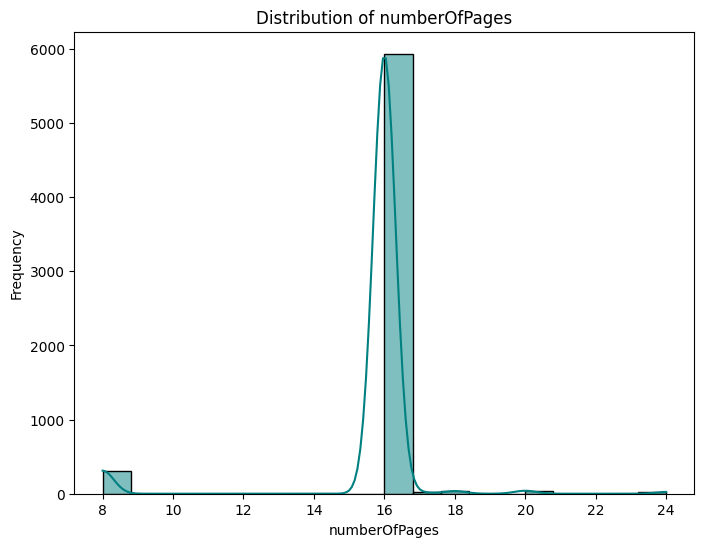

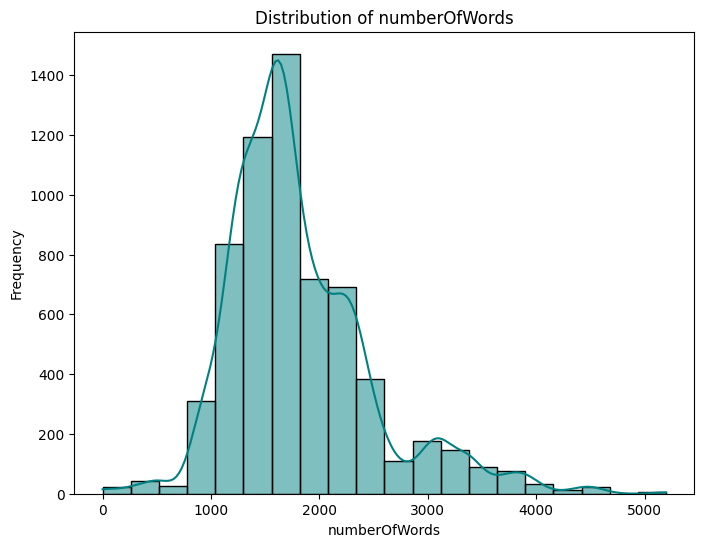

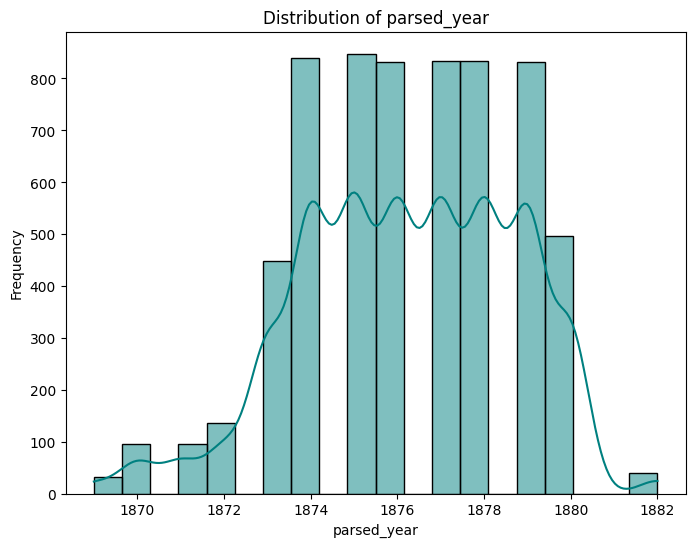

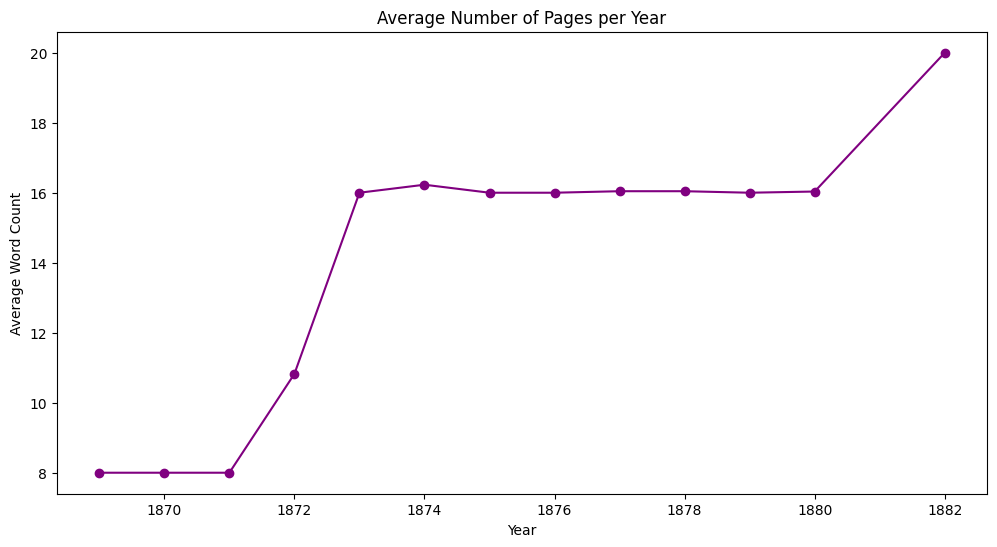

In [ ]:
# Drop 'text' column for metadata exploration
sp_df_metadata = sp_df.drop(columns=['text'], errors='ignore')

# Categorical data exploration
categorical_cols = ['editor', 'genre', 'language', 'place', 'publisher', 'serieTitle']


# Numerical data exploration
numerical_cols = ['numberOfPages', 'numberOfWords', 'parsed_year']

for col in numerical_cols:
    if col in sp_df_metadata:
        plt.figure(figsize=(8, 6))
        sns.histplot(sp_df_metadata[col].dropna(), kde=True, bins=20, color='teal')
        plt.title(f"Distribution of {col}")
        plt.xlabel(col)
        plt.ylabel("Frequency")
        plt.show()

# Grouping by year to visualize word count trends
if 'parsed_year' in sp_df_metadata and 'numberOfPages' in sp_df_metadata:
    plt.figure(figsize=(12, 6))
    sp_df_metadata.groupby('parsed_year')['numberOfPages'].mean().plot(kind='line', marker='o', color='purple')
    plt.title("Average Number of Pages per Year")
    plt.xlabel("Year")
    plt.ylabel("Average Word Count")
    plt.show()

### Metadata Exploration: Missing Values

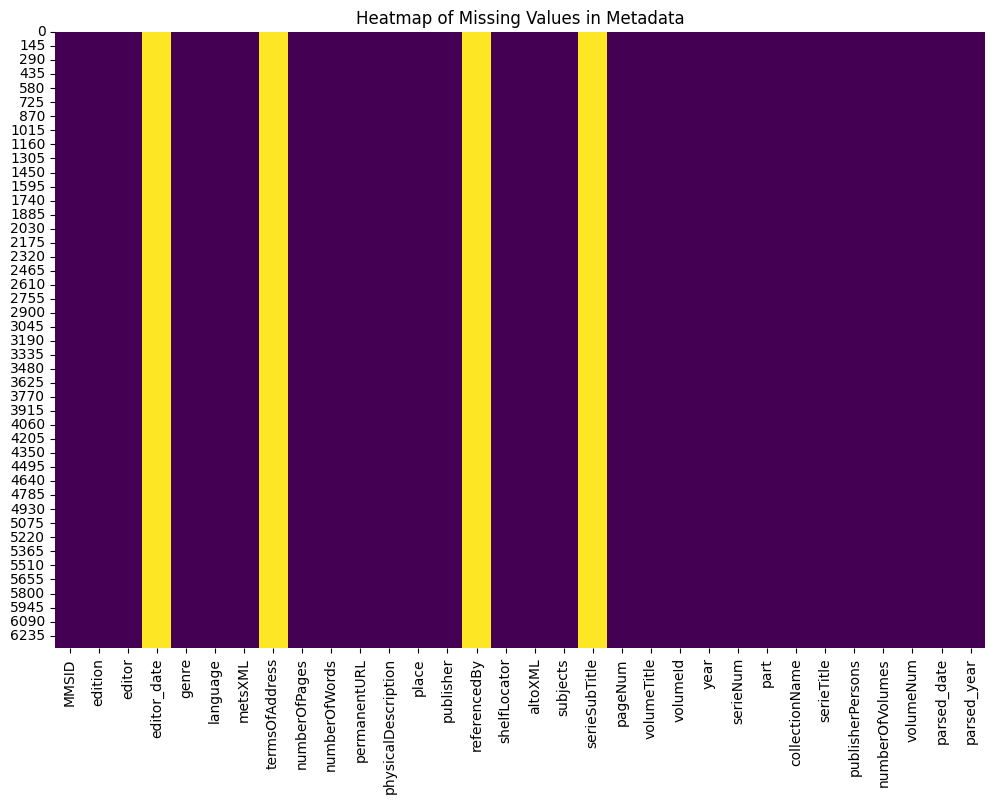

In [ ]:
plt.figure(figsize=(12, 8))
sns.heatmap(sp_df_metadata.isnull(), cbar=False, cmap='viridis')
plt.title("Heatmap of Missing Values in Metadata")
plt.show()


### Metadata Exploration: Publishers

It seems that we have 3 publishers, for each of the different Newspapers we have

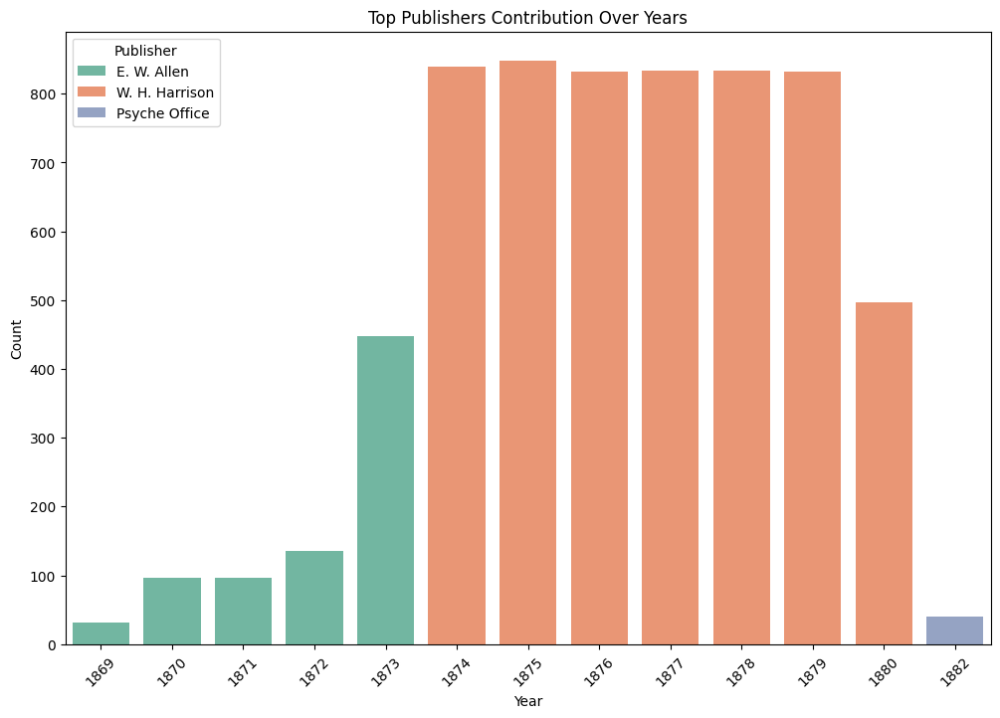

In [ ]:
if 'parsed_year' in sp_df_metadata and 'publisher' in sp_df_metadata:
    plt.figure(figsize=(12, 8))
    top_publishers = sp_df_metadata['publisher'].value_counts().head(5).index
    filtered_data = sp_df_metadata[sp_df_metadata['publisher'].isin(top_publishers)]
    sns.countplot(data=filtered_data, x='parsed_year', hue='publisher', palette='Set2')
    plt.title("Top Publishers Contribution Over Years")
    plt.xlabel("Year")
    plt.ylabel("Count")
    plt.xticks(rotation=45)
    plt.legend(title="Publisher")
    plt.show()


### Metadata Exploration: Genre and Language exploration

All of them are 'periodical' genre, and language is 'eng'.

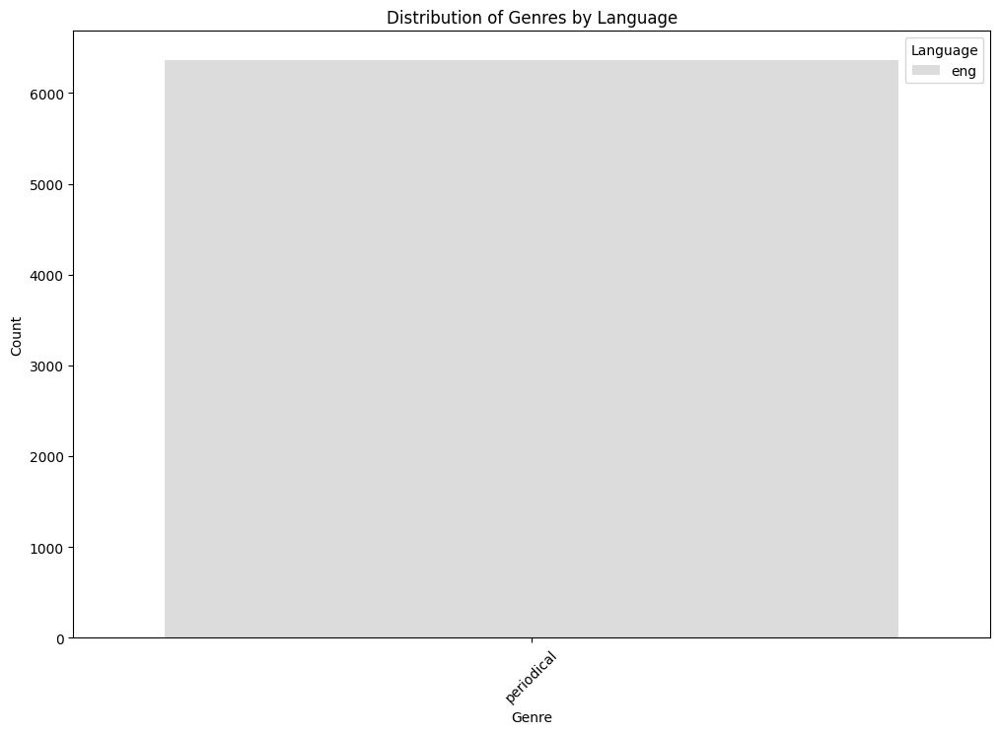

In [ ]:
if 'genre' in sp_df_metadata and 'language' in sp_df_metadata:
    plt.figure(figsize=(12, 8))
    sns.countplot(data=sp_df_metadata, x='genre', hue='language', palette='coolwarm')
    plt.title("Distribution of Genres by Language")
    plt.xlabel("Genre")
    plt.ylabel("Count")
    plt.xticks(rotation=45)
    plt.legend(title="Language")
    plt.show()


### Trends Over Time:: Numerical Exploration

Key numerical fields explored include:

* Number of Pages
* Number of Words
* Year

#### Correlations and Pairwise Analysis

Numerical columns such as numberOfPages, numberOfWords, and year were analyzed for relationships.

<ipython-input-18-d64eac3156ea>:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=sp_df_metadata, x='parsed_year', y='numberOfPages', palette='coolwarm')


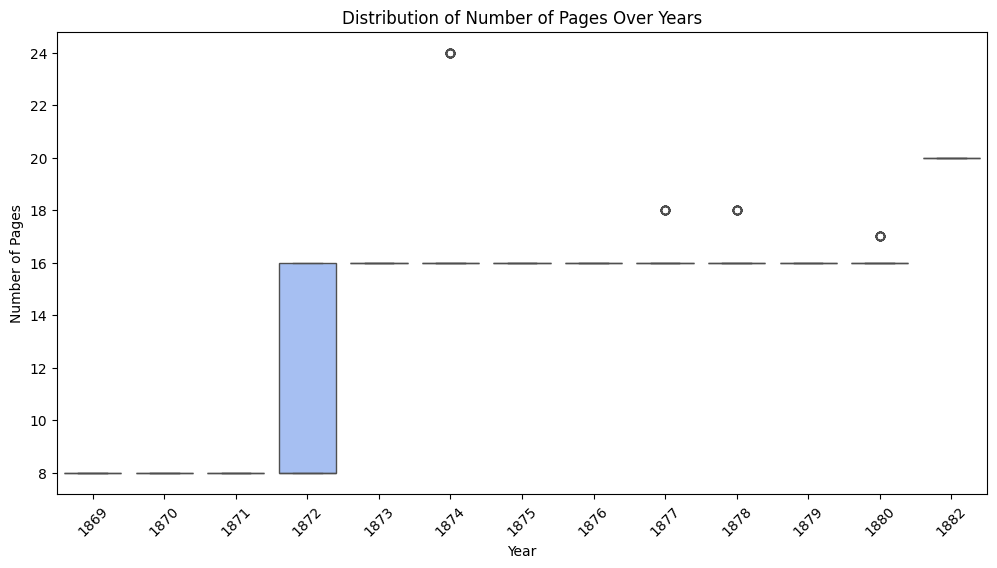

In [ ]:
if 'parsed_year' in sp_df_metadata and 'numberOfPages' in sp_df_metadata:
    plt.figure(figsize=(12, 6))
    sns.boxplot(data=sp_df_metadata, x='parsed_year', y='numberOfPages', palette='coolwarm')
    plt.title("Distribution of Number of Pages Over Years")
    plt.xlabel("Year")
    plt.ylabel("Number of Pages")
    plt.xticks(rotation=45)
    plt.show()


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1513: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=vector, **plot_kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1615: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=x, y=y, **kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1615: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  func(x=x, y=y, **kwargs)
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1615: UserWarning: Ignoring `palette` because no `hue` variable has been as

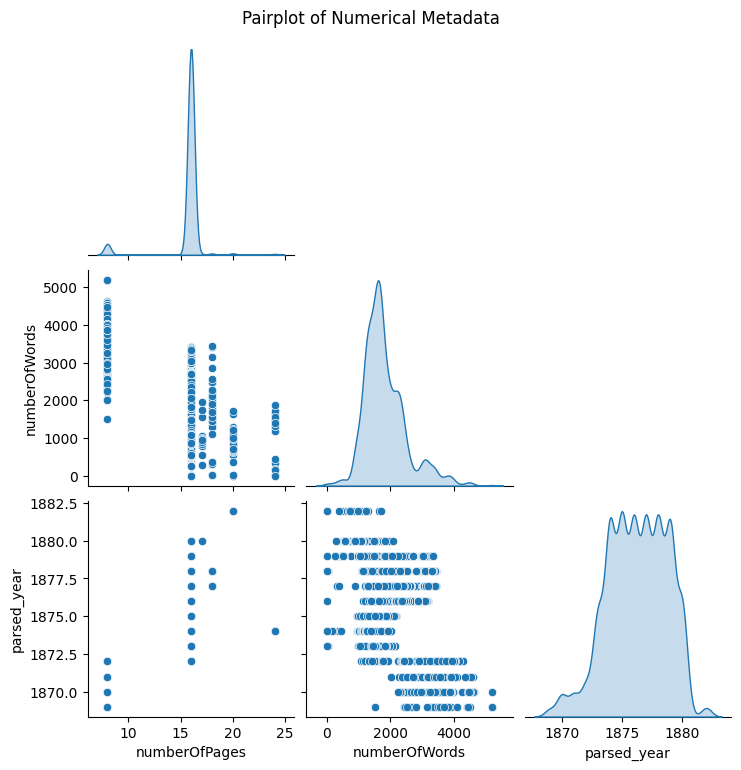

In [ ]:
numerical_columns = ['numberOfPages', 'numberOfWords', 'parsed_year']
pairplot_data = sp_df_metadata[numerical_columns].dropna()

sns.pairplot(pairplot_data, diag_kind='kde', corner=True, palette='coolwarm')
plt.suptitle("Pairplot of Numerical Metadata", y=1.02)
plt.show()


### The most Frequent Values

This visualization highlights the most frequent values for each categorical column in the dataset. The top 10 most common values are displayed in a bar chart for easy comparison.

Details:

* Top 10 Values:
  * The chart includes the 10 most frequent values in each column.
  * If the column has fewer than 10 unique values, all values are displayed.
  * The Y-axis represents the total number of pages across all newspaper issues (~6,000 pages in the dataset).

* Clarifications for Small Unique Value Columns:
  * A note is printed when a column contains fewer than 10 unique values to clarify that all values are being visualized.

* Purpose:
  * This visualization helps identify dominant or heavily represented values in the categorical metadata, such as the most frequent publishers, places, or languages.

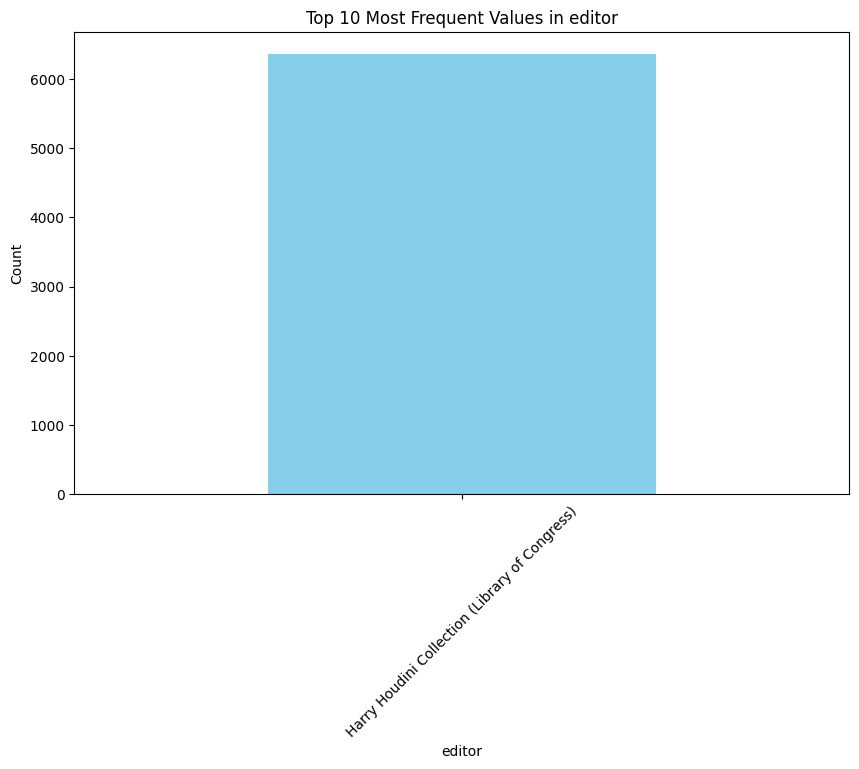

Note: Column 'editor' has only 1 unique values, so all values are shown here.


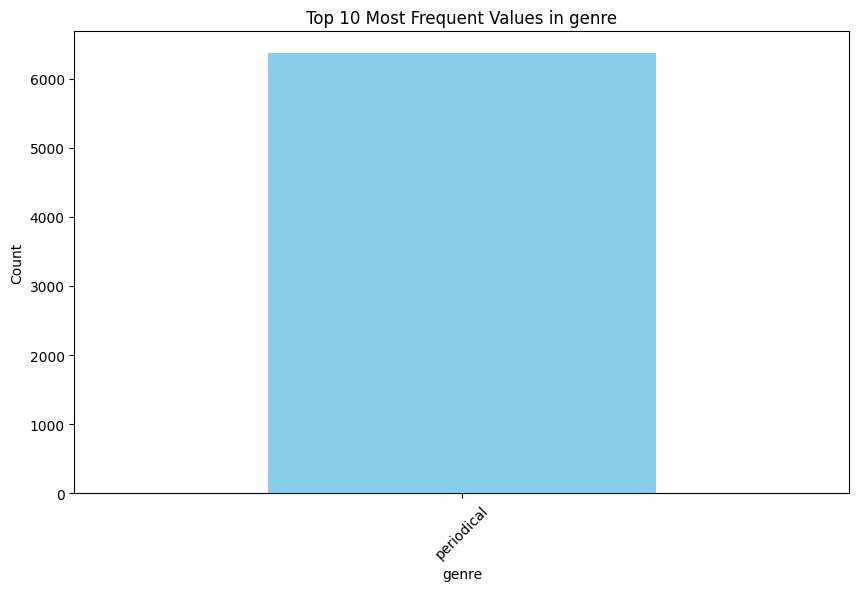

Note: Column 'genre' has only 1 unique values, so all values are shown here.


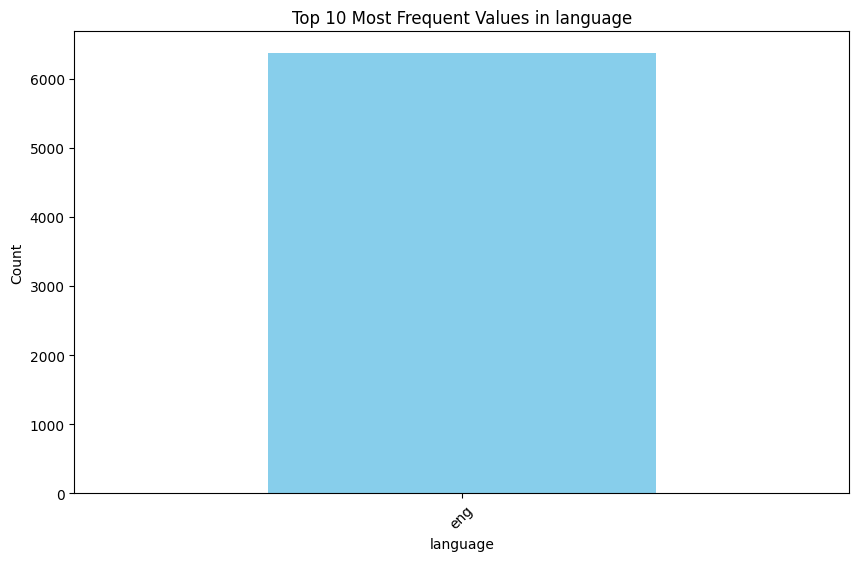

Note: Column 'language' has only 1 unique values, so all values are shown here.


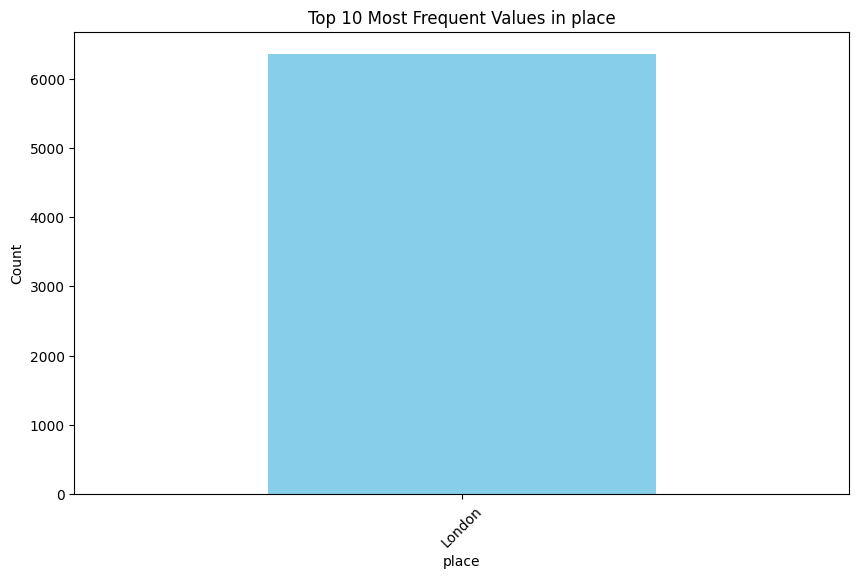

Note: Column 'place' has only 1 unique values, so all values are shown here.


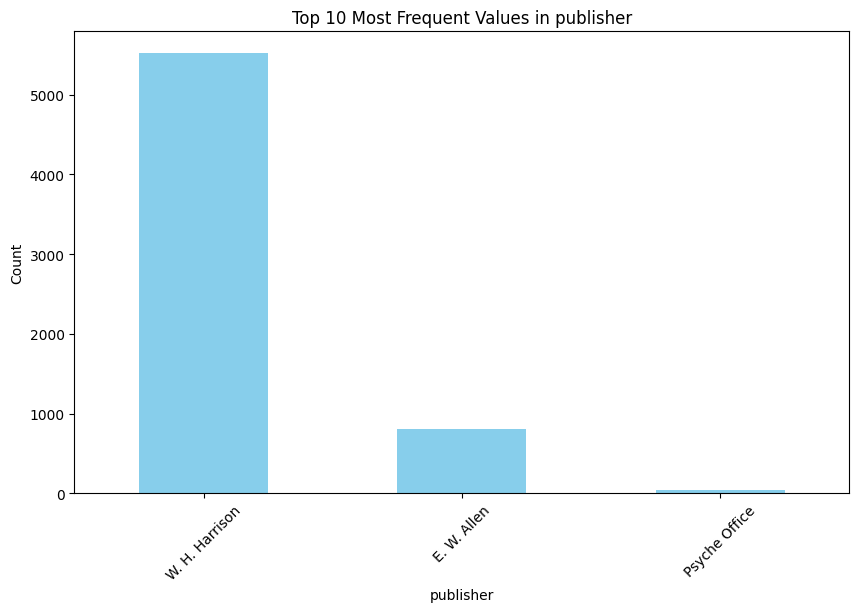

Note: Column 'publisher' has only 3 unique values, so all values are shown here.


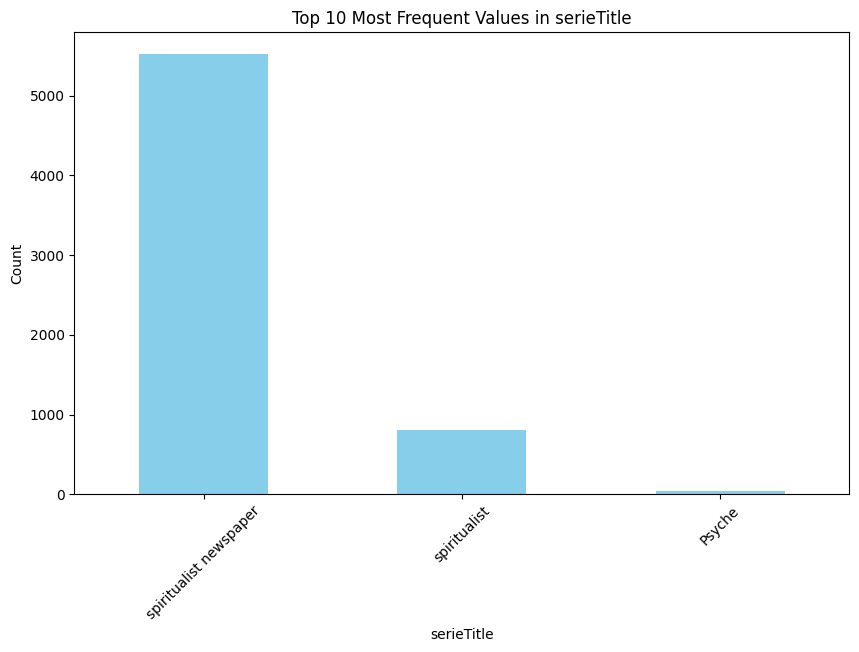

Note: Column 'serieTitle' has only 3 unique values, so all values are shown here.


In [ ]:
for col in categorical_cols:
    if col in sp_df_metadata:
        # Get the most frequent values (top 10)
        most_frequent_values = sp_df_metadata[col].value_counts().head(10)
        plt.figure(figsize=(10, 6))
        most_frequent_values.plot(kind='bar', color='skyblue')
        plt.title(f"Top 10 Most Frequent Values in {col}")
        plt.xlabel(col)
        plt.ylabel("Count")
        plt.xticks(rotation=45)
        plt.show()

        # Add a note if the column has fewer than 10 unique values
        if len(sp_df_metadata[col].value_counts()) <= 10:
            print(f"Note: Column '{col}' has only {len(sp_df_metadata[col].value_counts())} unique values, so all values are shown here.")


#### Visualizing Metadata Grouped by serieTitle

The dataset consists of multiple newspaper issues categorized under different serieTitle values, such as The Spiritualist, The Spiritualist Newspaper, and Psyche. This section explores the metadata grouped by serieTitle to uncover patterns and characteristics associated with each series.

* Purpose

 * Categorical Columns:
  * Identify the most frequent values for categorical metadata (e.g., editor, genre, language, place, publisher).
  * Visualize how these values vary across different series titles.
* Numerical Columns:
  * Compute and visualize the average values for numerical metadata (e.g., numberOfPages, numberOfWords, year) grouped by serieTitle.


* Grouping by serieTitle:
   * Data is grouped based on the serieTitle column to aggregate values for each series.

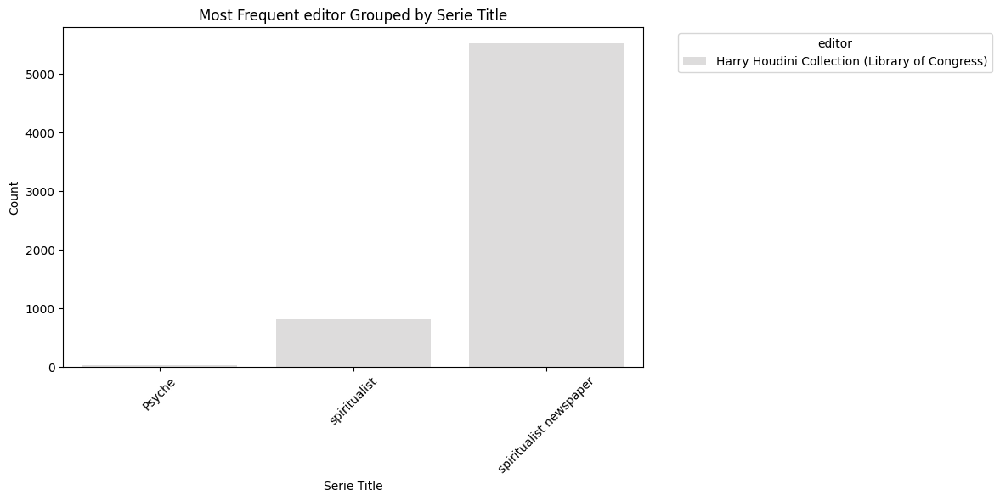

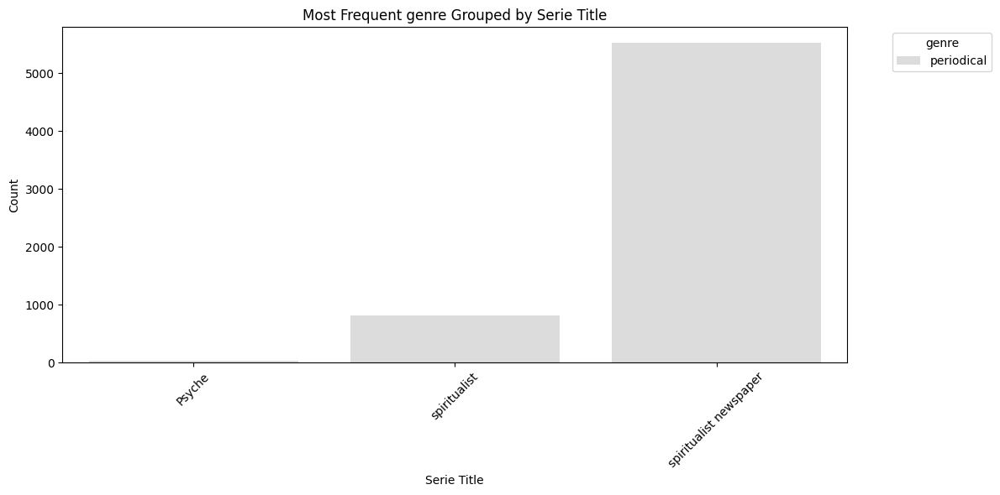

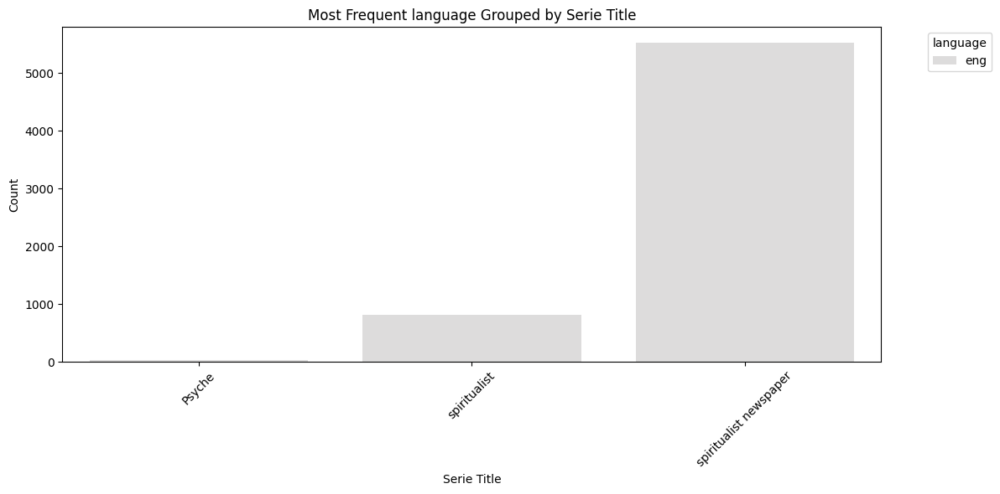

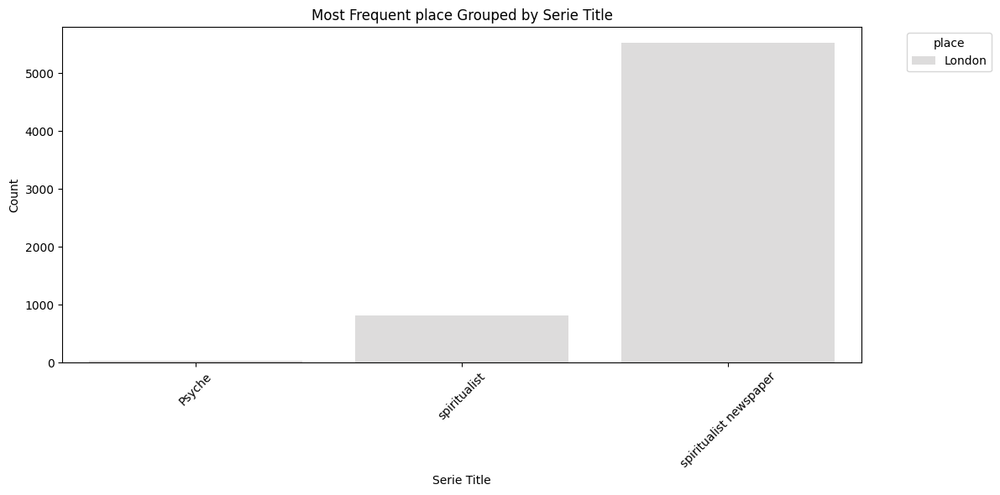

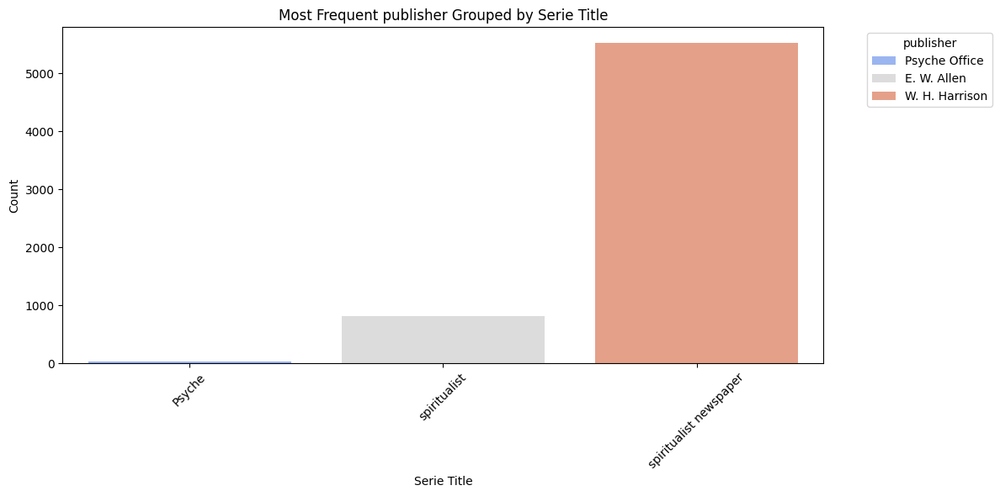

ValueError: cannot insert serieTitle, already exists

In [ ]:
# Ensure `serieTitle` is present in the dataset
if 'serieTitle' in sp_df_metadata.columns:
    grouped = sp_df_metadata.groupby('serieTitle')

    # Loop through categorical columns and visualize grouped results
    for col in categorical_cols:
        if col in sp_df_metadata:
            # Calculate the most frequent value in each group
            grouped_counts = grouped[col].agg(lambda x: x.value_counts().idxmax()).reset_index(name=col)
            grouped_counts['count'] = grouped[col].apply(lambda x: x.value_counts().max()).values

            plt.figure(figsize=(12, 6))
            sns.barplot(data=grouped_counts, x='serieTitle', y='count', hue=col, dodge=False, palette='coolwarm')
            plt.title(f"Most Frequent {col} Grouped by Serie Title")
            plt.xlabel("Serie Title")
            plt.ylabel("Count")
            plt.xticks(rotation=45)
            plt.legend(title=col, bbox_to_anchor=(1.05, 1), loc='upper left')
            plt.tight_layout()
            plt.show()

    # Loop through numerical columns and visualize grouped results
    for col in numerical_cols:
        if col in sp_df_metadata:
            plt.figure(figsize=(12, 6))
            grouped[col].mean().plot(kind='bar', color='skyblue', width=0.8)
            plt.title(f"Average {col} Grouped by Serie Title")
            plt.xlabel("Serie Title")
            plt.ylabel(f"Average {col}")
            plt.xticks(rotation=45)
            plt.tight_layout()
            plt.show()
else:
    print("The column 'serieTitle' is missing from the dataset.")



####  Others

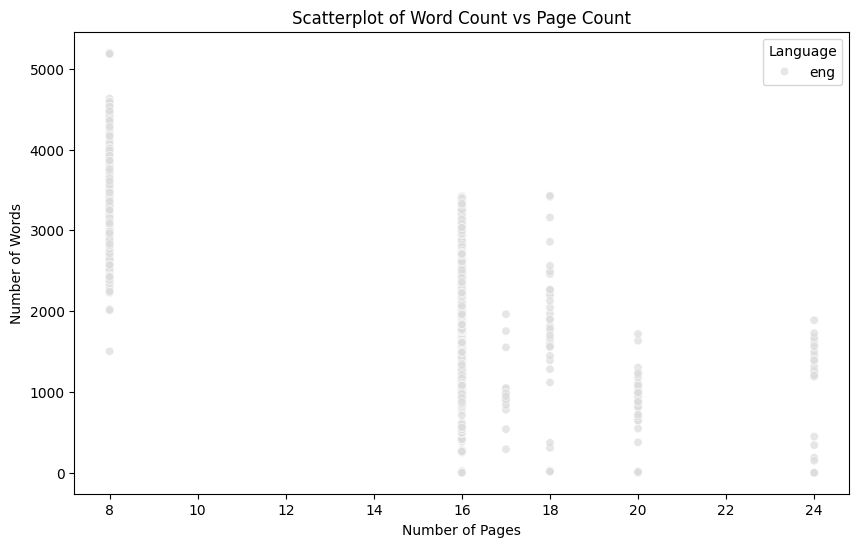

In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(data=sp_df_metadata, x='numberOfPages', y='numberOfWords', hue='language', palette='coolwarm', alpha=0.7)
plt.title("Scatterplot of Word Count vs Page Count")
plt.xlabel("Number of Pages")
plt.ylabel("Number of Words")
plt.legend(title="Language")
plt.show()


##### Overview of Categorical and Numerical Metadata in the Dataset

This analysis provides an overview of the dataset's categorical and numerical metadata. For categorical fields, the bar chart displays the number of unique values across each metadata field, offering insights into their diversity and variability.

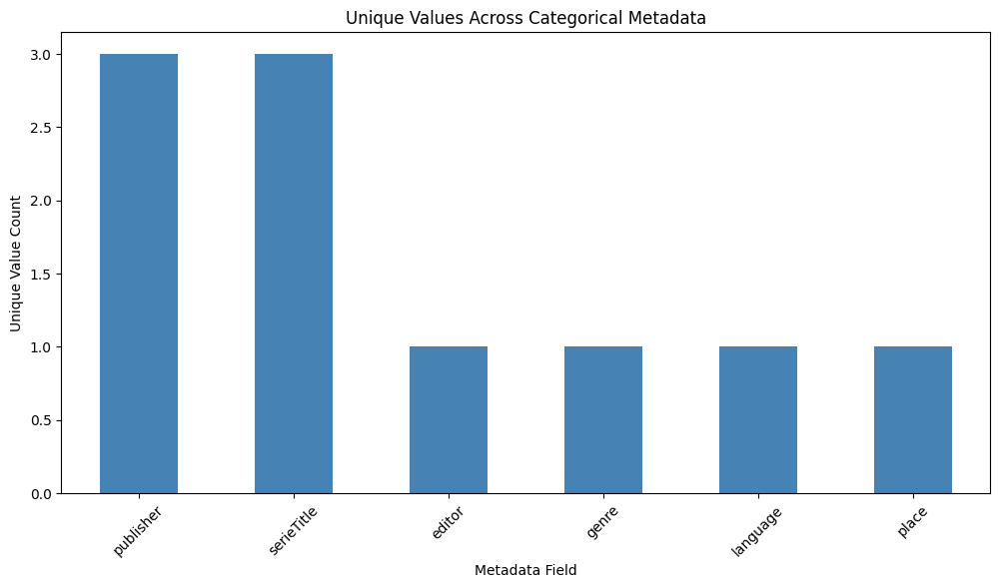

                count         mean         std     min     25%     50%  \
numberOfPages  6365.0    15.677141    1.844076     8.0    16.0    16.0   
numberOfWords  6365.0  1817.024980  673.334023     0.0  1376.0  1668.0   
parsed_year    6365.0  1876.240377    2.460314  1869.0  1874.0  1876.0   

                  75%     max  
numberOfPages    16.0    24.0  
numberOfWords  2145.0  5199.0  
parsed_year    1878.0  1882.0  


In [ ]:
# Categorical overview
cat_summary = sp_df_metadata[categorical_cols].nunique().sort_values(ascending=False)
plt.figure(figsize=(12, 6))
cat_summary.plot(kind='bar', color='steelblue')
plt.title("Unique Values Across Categorical Metadata")
plt.xlabel("Metadata Field")
plt.ylabel("Unique Value Count")
plt.xticks(rotation=45)
plt.show()

# Numerical overview
num_summary = sp_df_metadata[numerical_columns].describe().transpose()
print(num_summary)


##### Exploring Correlations: Number of Pages vs. Words Across Languages

This visualization examines the relationship between the number of pages and the number of words in the dataset, segmented by language

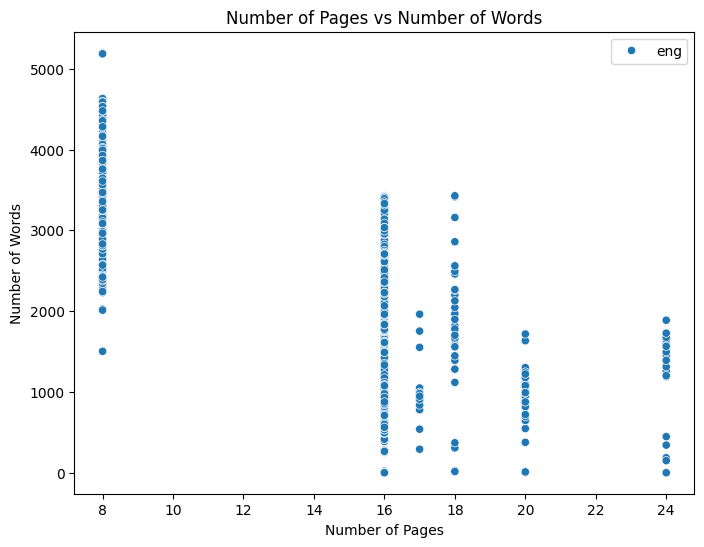

In [ ]:
# Correlation between number of words and pages
plt.figure(figsize=(8, 6))
sns.scatterplot(data=sp_df_metadata, x='numberOfPages', y='numberOfWords', hue='language')
plt.title("Number of Pages vs Number of Words")
plt.xlabel("Number of Pages")
plt.ylabel("Number of Words")
plt.legend()
plt.show()


##### Analyzing Publication Trends: Yearly Pages and Issues by Series Title

This code performs an analysis of publication metadata by grouping data by year (parsed_year) and series title (serieTitle) to calculate the total number of pages and unique issues (represented by volumeId) for each combination. The grouped data is then visualized in two bar plots.

The first plot illustrates the total number of pages published per year for each series title, using a cool-to-warm color palette for better visual differentiation.

The second plot showcases the number of unique issues published per year by series title, utilizing a distinct color palette (Set2).

Both plots are designed with rotated x-axis labels for readability and include informative titles, axis labels, and legends to facilitate understanding of trends over time across different series titles. These visualizations provide valuable insights into the publication patterns of the dataset, enabling comparisons between series titles and identifying

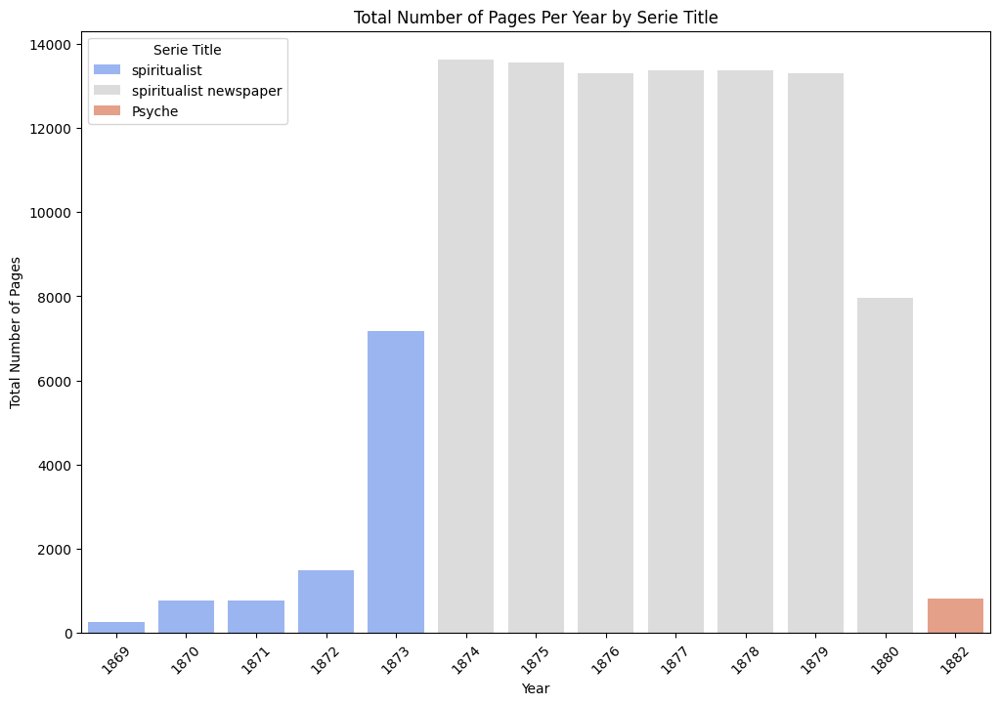

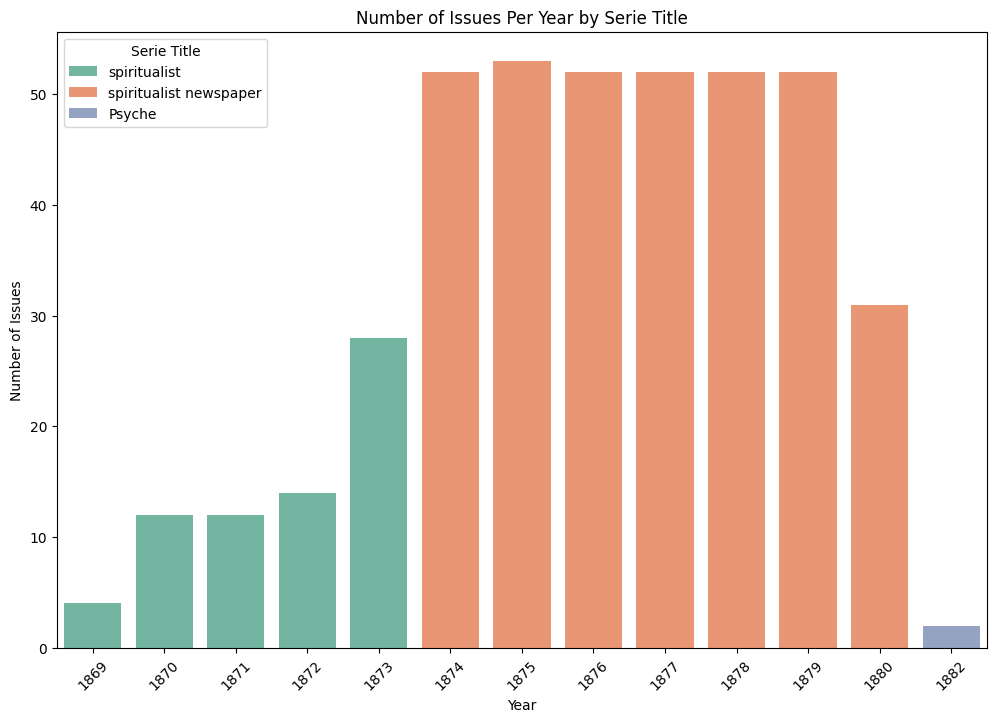

In [ ]:
# Grouping data by year and serieTitle for pages and issues
grouped_data = sp_df_metadata.groupby(['parsed_year', 'serieTitle']).agg(
    total_pages=('numberOfPages', 'sum'),
    num_issues=('volumeId', 'nunique')  # Counting unique issues (volumeId)
).reset_index()

# Plot: Total Number of Pages Per Year by serieTitle
plt.figure(figsize=(12, 8))
sns.barplot(
    data=grouped_data,
    x='parsed_year',
    y='total_pages',
    hue='serieTitle',
    palette='coolwarm'
)
plt.title("Total Number of Pages Per Year by Serie Title")
plt.xlabel("Year")
plt.ylabel("Total Number of Pages")
plt.xticks(rotation=45)
plt.legend(title="Serie Title")
plt.show()

# Plot: Number of Issues Per Year by serieTitle
plt.figure(figsize=(12, 8))
sns.barplot(
    data=grouped_data,
    x='parsed_year',
    y='num_issues',
    hue='serieTitle',
    palette='Set2'
)
plt.title("Number of Issues Per Year by Serie Title")
plt.xlabel("Year")
plt.ylabel("Number of Issues")
plt.xticks(rotation=45)
plt.legend(title="Serie Title")
plt.show()


## Segmenting Text Articles:

Segment articles based on uppercase headings, extract article titles and content, and analyze thematic patterns. [TODO]

### Exploring the different lyouts

We have 3 different newspapers: spiritualist, spiritualist newspaper, physche.

We are going to quickly obtain the metXML and altoXML of three pages from each type newspaper. More research needs to be done, to see if the articles within a page have a different layout even within the same type of newspaper. This is just a very preliminary exploration

In [ ]:

#get the first, second  and third page of the first spiritualist  issue
sp_type1_a=sp_df[sp_df["parsed_year"]==1869].loc[0]
sp_type1_b=sp_df[sp_df["parsed_year"]==1869].loc[1]
sp_type1_c=sp_df[sp_df["parsed_year"]==1869].loc[2]

#get the first, second  and third  of the first spiritualist newspaper issue
sp_type2_a=sp_df[sp_df["parsed_year"]==1874].loc[800]
sp_type2_b=sp_df[sp_df["parsed_year"]==1874].loc[801]
sp_type2_c=sp_df[sp_df["parsed_year"]==1874].loc[802]

#get the first, second  and third of the first Pysche  issue
sp_type3_a=sp_df[sp_df["parsed_year"]==1882].loc[6317]
sp_type3_b=sp_df[sp_df["parsed_year"]==1882].loc[6318]
sp_type3_c=sp_df[sp_df["parsed_year"]==1882].loc[6319]

sp_type1_a_metsxml=sp_type1_a['metsXML']
sp_type1_a_altoxml=sp_type1_a['altoXML']

sp_type1_b_metsxml=sp_type1_b['metsXML']
sp_type1_b_altoxml=sp_type1_b['altoXML']

sp_type1_c_metsxml=sp_type1_c['metsXML']
sp_type1_c_altoxml=sp_type1_c['altoXML']

sp_type2_a_metsxml=sp_type2_a['metsXML']
sp_type2_a_altoxml=sp_type2_a['altoXML']

sp_type2_b_metsxml=sp_type2_b['metsXML']
sp_type2_b_altoxml=sp_type2_b['altoXML']

sp_type2_c_metsxml=sp_type2_c['metsXML']
sp_type2_c_altoxml=sp_type2_c['altoXML']

sp_type3_a_metsxml=sp_type3_a['metsXML']
sp_type3_a_altoxml=sp_type3_a['altoXML']

sp_type3_b_metsxml=sp_type3_b['metsXML']
sp_type3_b_altoxml=sp_type3_b['altoXML']


sp_type3_c_metsxml=sp_type3_c['metsXML']
sp_type3_c_altoxml=sp_type3_c['altoXML']


In [ ]:
print("Type 1: Spiritualist, year 1869, page 1")
print(sp_type1_a_metsxml)
print(sp_type1_a_altoxml)

print("-----")
print("Type 1: Spiritualist, year 1869, page 2")
print(sp_type1_b_metsxml)
print(sp_type1_b_altoxml)

print("-----")
print("Type 1: Spiritualist, year 1869, page 3")
print(sp_type1_c_metsxml)
print(sp_type1_c_altoxml)

print("----------------")

print("Type 2: Spiritualist Newspaper, year 1874, page 1")
print(sp_type2_a_metsxml)
print(sp_type2_a_altoxml)

print("-----")

print("Type 2: Spiritualist Newspaper, year 1874, page 2")
print(sp_type2_b_metsxml)
print(sp_type2_b_altoxml)

print("-----")

print("Type 2: Spiritualist Newspaper, year 1874, page 3")
print(sp_type2_c_metsxml)
print(sp_type2_c_altoxml)

print("----------------")

print("Type 3: Psyche, year 1882, page 1")
print(sp_type3_a_metsxml)
print(sp_type3_a_altoxml)
print("-----")

print("Type 3: Psyche, year 1882, page 2")
print(sp_type3_b_metsxml)
print(sp_type3_b_altoxml)

print("-----")

print("Type 3: Psyche, year 1882, page 3")
print(sp_type3_c_metsxml)
print(sp_type3_c_altoxml)


Type 1: Spiritualist, year 1869, page 1
135908617-mets.xml
135908617/alto/137375556.34.xml
-----
Type 1: Spiritualist, year 1869, page 2
135908617-mets.xml
135908617/alto/137375568.34.xml
-----
Type 1: Spiritualist, year 1869, page 3
135908617-mets.xml
135908617/alto/137375580.34.xml
----------------
Type 2: Spiritualist Newspaper, year 1874, page 1
135908688-mets.xml
135908688/alto/137168403.34.xml
-----
Type 2: Spiritualist Newspaper, year 1874, page 2
135908688-mets.xml
135908688/alto/137168415.34.xml
-----
Type 2: Spiritualist Newspaper, year 1874, page 3
135908688-mets.xml
135908688/alto/137168427.34.xml
----------------
Type 3: Psyche, year 1882, page 1
136346239-mets.xml
136346239/alto/137372916.34.xml
-----
Type 3: Psyche, year 1882, page 2
136346239-mets.xml
136346239/alto/137372928.34.xml
-----
Type 3: Psyche, year 1882, page 3
136346239-mets.xml
136346239/alto/137372940.34.xml


##### Type 1 Layout: Spiritualist

* Type 1: Spiritualist, year 1869, page 1
 * 135908617/image/137375556.3.jpg

* Type 1: Spiritualist, year 1869, page 2
  * 135908617/image/137375568.3.jpg

* Type 1: Spiritualist, year 1869, page 3
  * 135908617/image/137375580.3.jpg

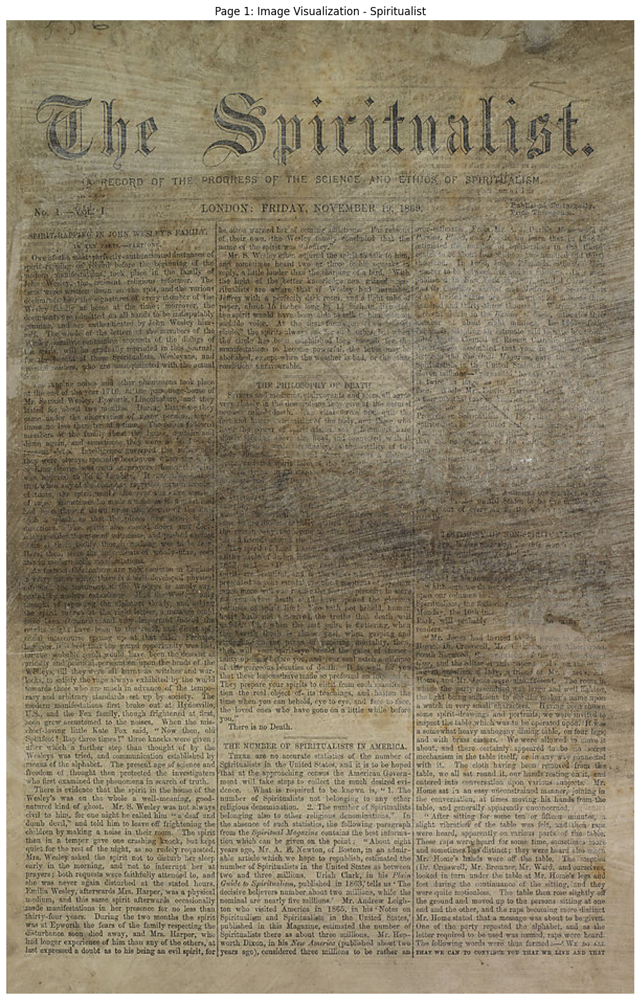

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def display_image(image_path, title="Image Visualization"):
    """
    Display an image with a custom title.

    Parameters:
        image_path (str): Path to the image file.
        title (str): Title for the image display. Defaults to "Image Visualization".
    """
    try:
        # Load and display the image
        img = mpimg.imread(image_path)

        plt.figure(figsize=(20, 20))  # Set the figure size
        plt.imshow(img)              # Display the image
        plt.axis('off')              # Hide axes for better visualization
        plt.title(title)             # Add a title
        plt.show()

    except FileNotFoundError:
        print(f"Error: The file '{image_path}' was not found. Please check the path.")
    except Exception as e:
        print(f"An error occurred: {e}")

image_path = '/content/137375556.3.jpg'  # Replace with your image path
display_image(image_path, title="Page 1: Image Visualization - Spiritualist")


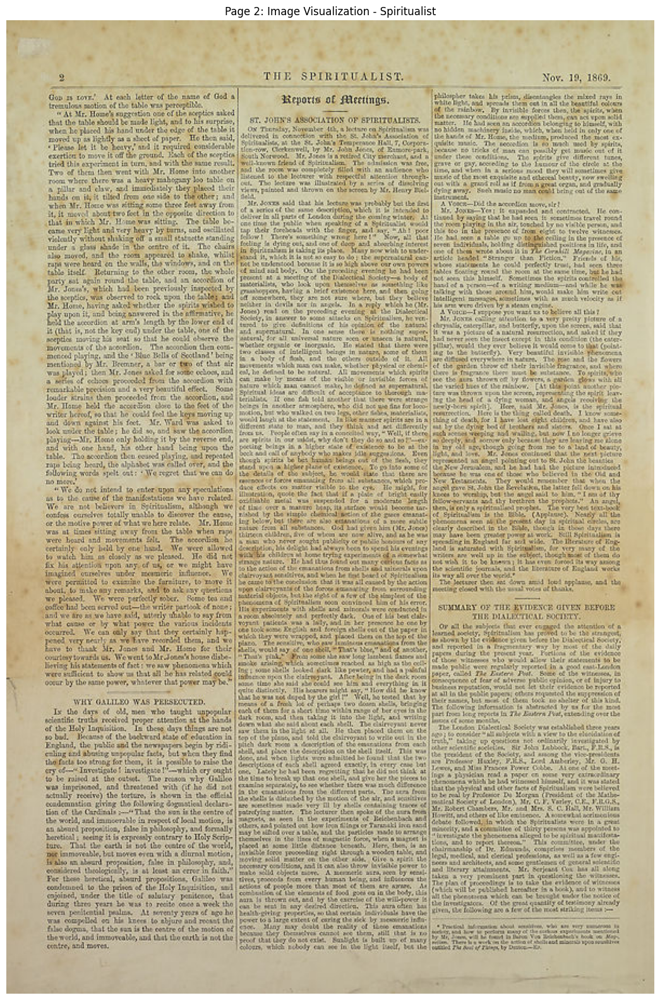

In [ ]:
image_path = '/content/137375568.3.jpg'  # Replace with your image path
display_image(image_path, title="Page 2: Image Visualization - Spiritualist")

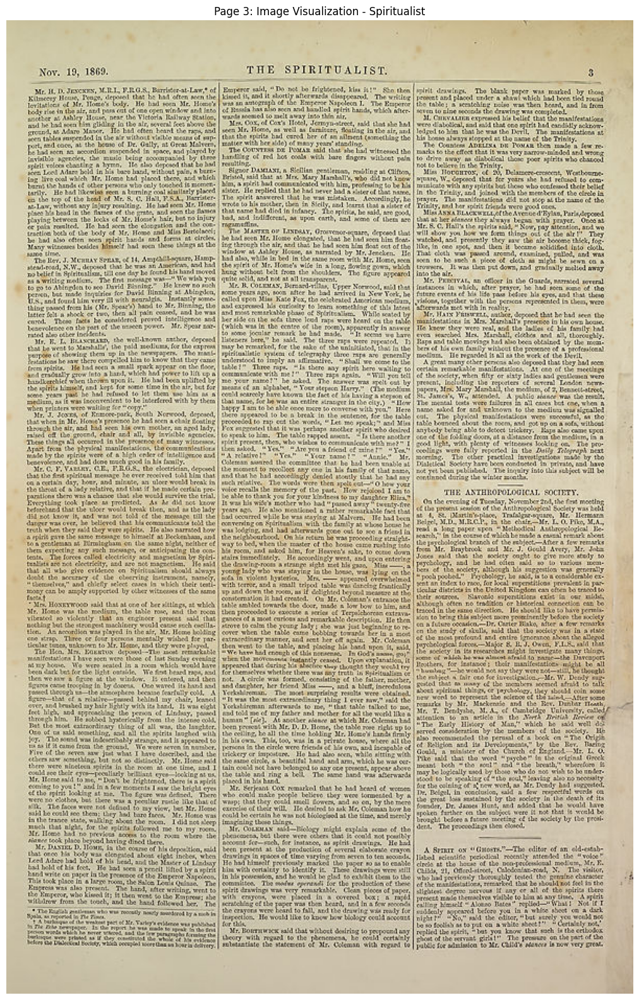

In [ ]:
image_path = '/content/137375580.3.jpg'  # Replace with your image path
display_image(image_path, title="Page 3: Image Visualization - Spiritualist")

**Note** that even pages (e.g. page 2) has the page number in the left and date on the right; and odd pages (e.g. page 3) have these on the other way around. Also, the first page has a different layout.(

#### Type 2 Layout: Spiritualist Newspapers

* Type 2: Spiritualist Newspaper, year 1874, page 1
  * 135908688/alto/137168403.3.jpg

* Type 2: Spiritualist Newspaper, year 1874, page 2
  * 135908688/alto/137168415.3.jpg

* Type 2: Spiritualist Newspaper, year 1874, page 3
  * 135908688/alto/137168427.3.jpg

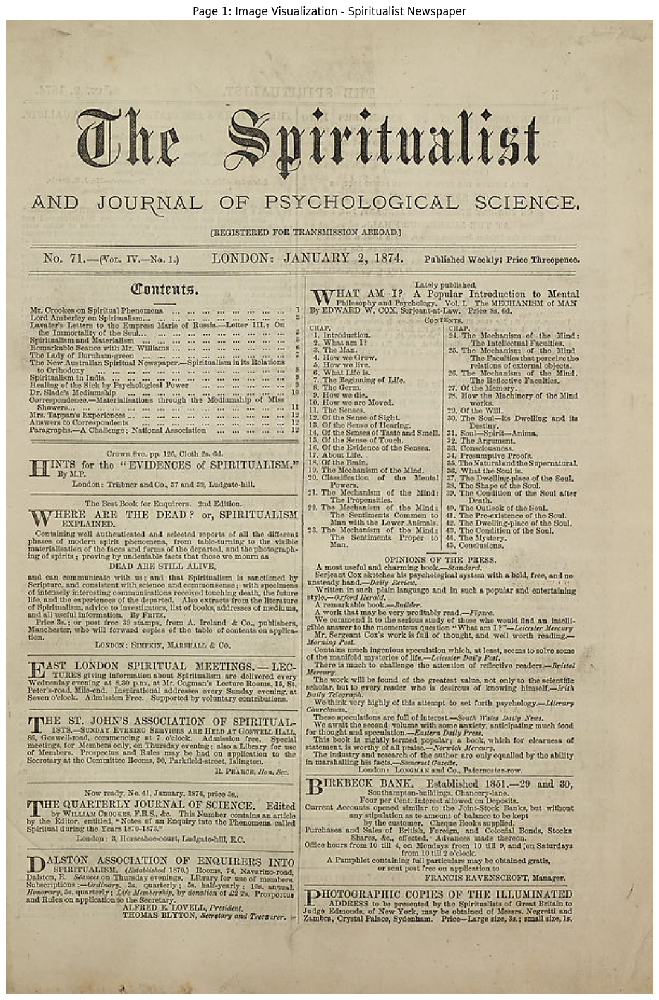

In [ ]:
image_path = '/content/137168403.3.jpg'
display_image(image_path, title="Page 1: Image Visualization - Spiritualist Newspaper")

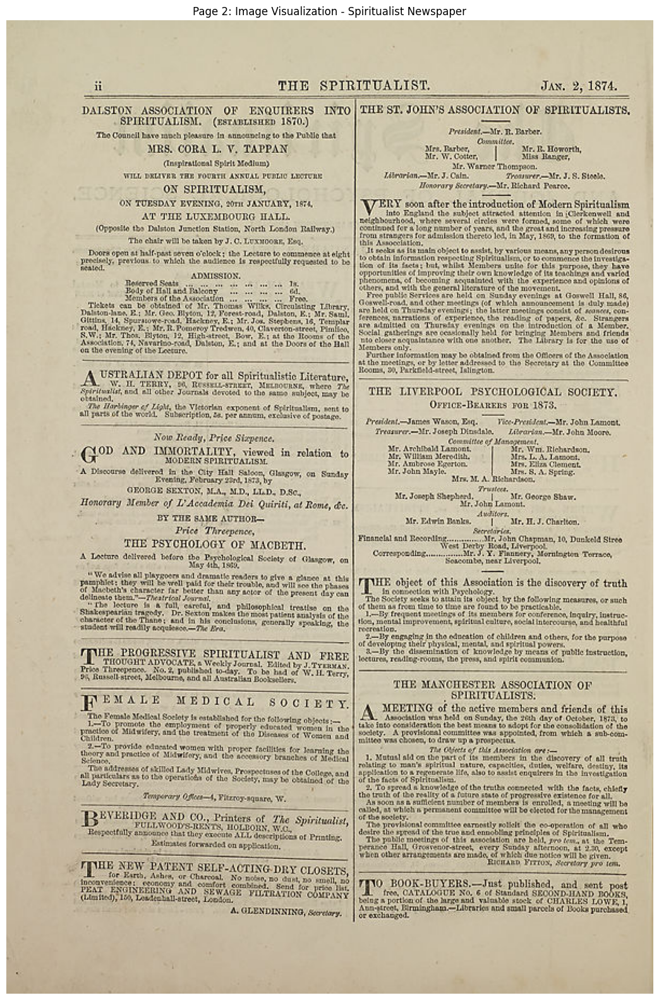

In [ ]:
image_path = '/content/137168415.3.jpg'
display_image(image_path, title="Page 2: Image Visualization - Spiritualist Newspaper")

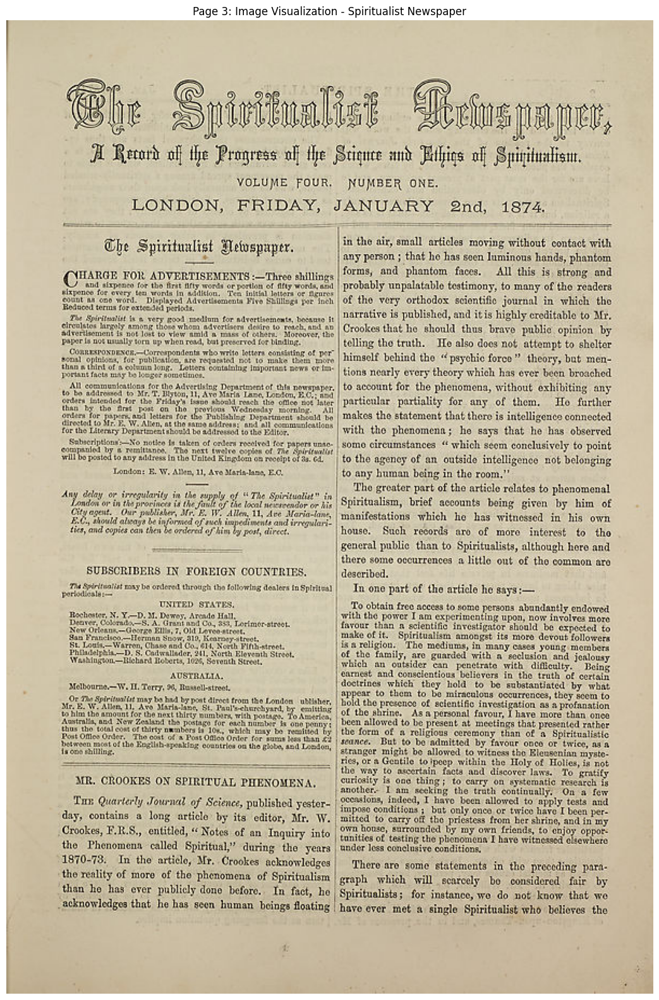

In [ ]:
image_path = '/content/137168427.3.jpg'
display_image(image_path, title="Page 3: Image Visualization - Spiritualist Newspaper")

#### Type 3 Layout: Psyche

* Type 3: Psyche, year 1882, page 1
  * 136346239/alto/137372916.3.jpg

* Type 3: Psyche, year 1882, page 2
  * 136346239/alto/137372928.3.jpg

* Type 3: Psyche, year 1882, page 3
  * 136346239/alto/137372940.3.jpg

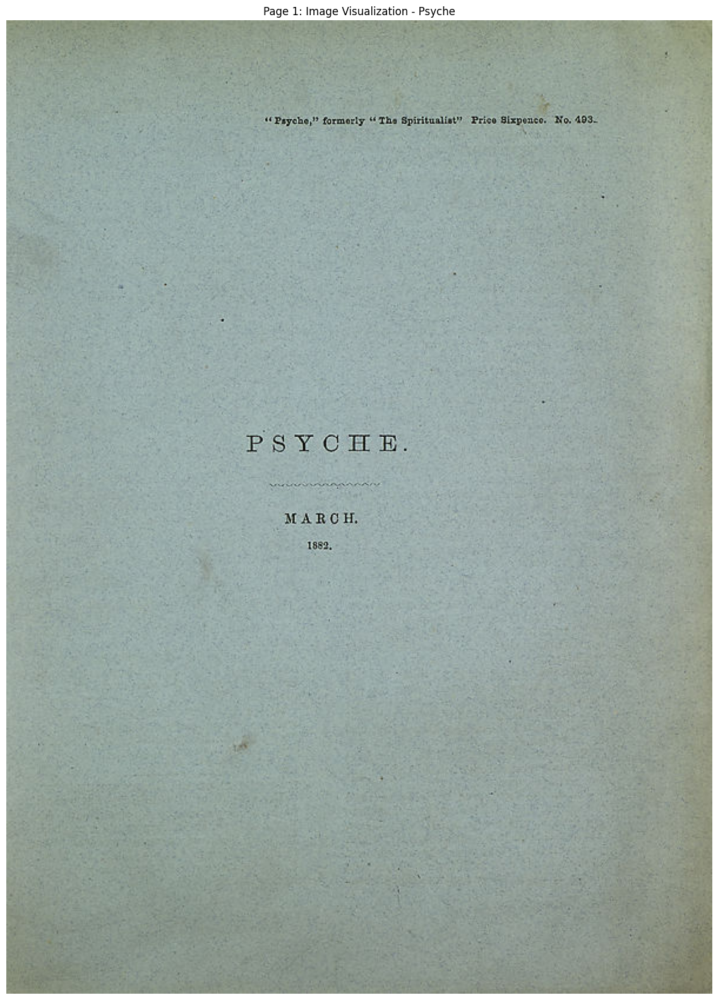

In [ ]:
image_path = '/content/137372916.3.jpg'
display_image(image_path, title="Page 1: Image Visualization - Psyche")

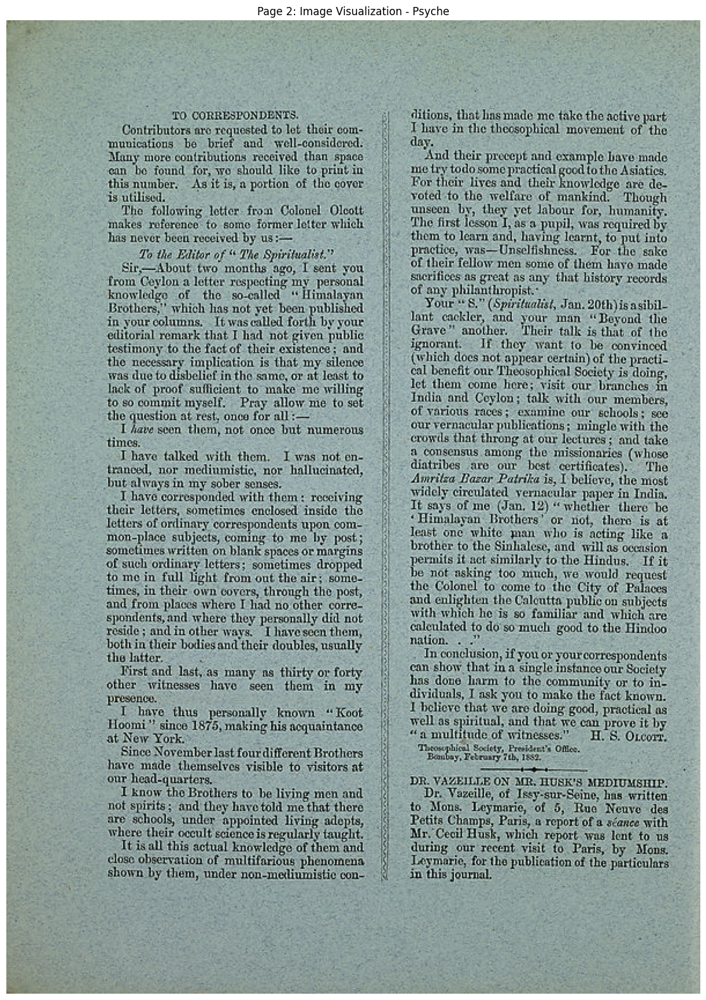

In [ ]:
image_path = '/content/137372928.3.jpg'
display_image(image_path, title="Page 2: Image Visualization - Psyche")

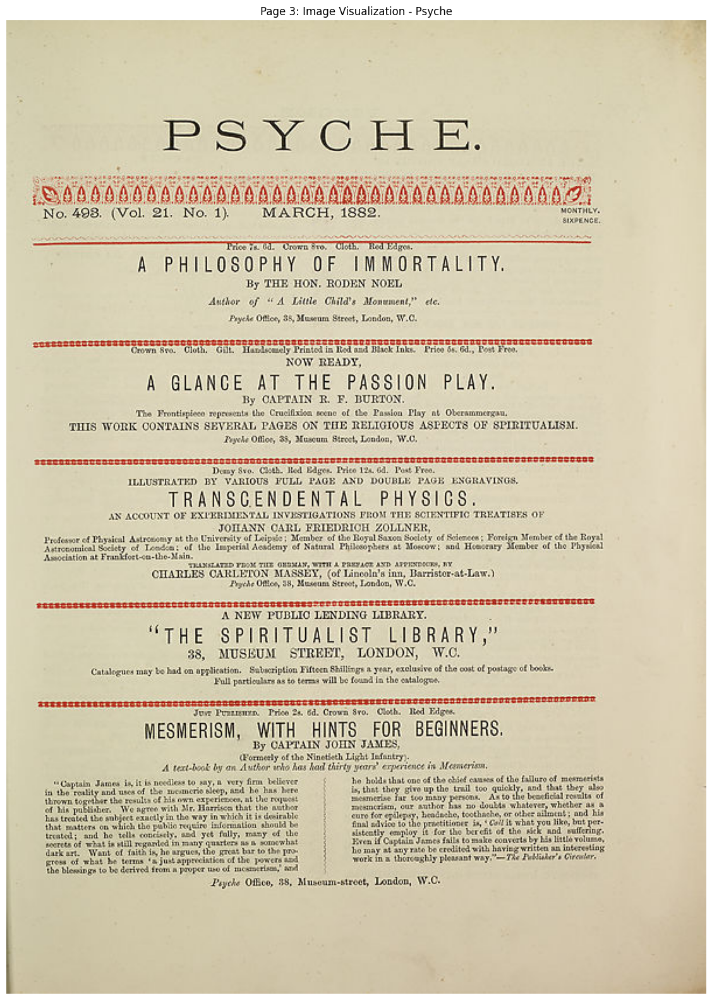

In [ ]:
image_path = '/content/137372940.3.jpg'
display_image(image_path, title="Page 3: Image Visualization - Psyche")

#### Articles Extraction

We can see that different newspapers types, have different layouts. So we might have to create different articles extraction heuristics for different newspapers.

Right now, I just play with the first type - **the spiritualist**

In [ ]:
### Lets start trying to segment the articles of one particular page:  the first issue and second page
articles=sp_df['text'][1]
file_path = "articles.txt"
with open(file_path, "w") as file:
    file.write(articles)


In [ ]:
articles

"2 THE SPIRITUALIST. Nov. 19, 1869. GOD IS DOTE.’ At each, letter of the name of God a tremulous motion of the table was perceptible. “ At Mr. Home’s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, ‘ Please let it be heavy,’ and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet in the opposite direction to that in which Mr. Home was sitting. The table became very light and very heavy by turns, and oscillated violently without shaking off a small statuette standi

### Regex: Rule Base (It is a prototype)

**Note - this still doesnt work well!** I havent spent much time on this.

In [ ]:
segmented_articles = segment_page_articles(articles)
segmented_articles

Header: Number=None, Title=None, Date=None
Remaining Lines: ['2 THE SPIRITUALIST.', 'Nov.', '19, 1869.', 'GOD IS DOTE.’ At each, letter of the name of God a tremulous motion of the table was perceptible.', '“ At Mr.']... (truncated for display)
Segmented Articles: {'page_title': None, 'page_date': None, 'page_number': None, 'total_articles': 3, 'articles': [{'title': '2 THE SPIRITUALIST.', 'text': 'Nov. '}, {'title': '19, 1869.', 'text': "GOD IS DOTE.’ At each, letter of the name of God a tremulous motion of the table was perceptible. “ At Mr. Home’s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, ‘ Please let it be heavy,’ and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there wa

{'page_title': None,
 'page_date': None,
 'page_number': None,
 'total_articles': 3,
 'articles': [{'title': '2 THE SPIRITUALIST.', 'text': 'Nov. '},
  {'title': '19, 1869.',
   'text': "GOD IS DOTE.’ At each, letter of the name of God a tremulous motion of the table was perceptible. “ At Mr. Home’s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, ‘ Please let it be heavy,’ and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet in the opposite direction to that in

In [ ]:
for i in range (0, len(segmented_articles['articles'])):
  print (segmented_articles['articles'][i]['title'])

2 THE SPIRITUALIST.
19, 1869.
SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALECTICAL SOCIETY.


#### DATAFRAME GENERATION: df_articles_rb

This is very important. I want to generate a dataframe with as many rows as articles. I want to preserve the newspaper id (issue_id) the page id (page_id), and all the information extracted. Now we are just working with one page, but in the future, this dataframe (df_articles_rb) has to have as many rows as articles detected in all the pages of all newspapers. And we need to identify allways the newspaper that each article (issue_id / volumeId) is from, the page id (page_id / altoXML), the number of the page, title of the newspaper, page number, date, number of articles, the title of the articile, the text of the article.

Note that since the rule_base extraction doesnt work well,the information that we obtain now is not correct


In [ ]:
# Initialize an empty list to store articles data
articles_data = []

# Function to process a single page and append articles data
def process_page_articles(issue_id, page_id, segmented_articles):
    """
    Processes articles for a single page and appends to the global articles_data list.

    Args:
        issue_id (str): ID of the newspaper issue.
        page_id (str): ID of the page.
        segmented_articles (dict): Dictionary containing segmented articles data.
    """
    # Extract page-level information
    page_title = segmented_articles.get("page_title", None)
    page_date = segmented_articles.get("page_date", None)
    page_number = segmented_articles.get("page_number", None)
    total_articles = segmented_articles.get("total_articles", 0)

    # Iterate over articles
    for article in segmented_articles.get("articles", []):
        article_title = article.get("title", None)
        article_text = article.get("text", None)

        # Append article data as a dictionary
        articles_data.append({
            "issue_id": issue_id,
            "page_id": page_id,
            "page_title": page_title,
            "page_date": page_date,
            "page_number": page_number,
            "total_articles": total_articles,
            "article_title": article_title,
            "article_text": article_text
        })

# Example Usage for a Single Page
# Assuming 'segmented_articles' contains extracted article information
issue_id = sp_df['volumeId'][1]  # Replace with the correct issue_id column
page_id = sp_df['altoXML'][1]    # Replace with the correct page_id column

# Call the function to process the page and articles
process_page_articles(issue_id, page_id, segmented_articles)

# Convert the articles data into a DataFrame
df_articles_rb = pd.DataFrame(articles_data)

# Display the resulting DataFrame
print(df_articles_rb.head())


    issue_id                          page_id page_title page_date  \
0  135908617  135908617/alto/137375568.34.xml       None      None   
1  135908617  135908617/alto/137375568.34.xml       None      None   
2  135908617  135908617/alto/137375568.34.xml       None      None   

  page_number  total_articles  \
0        None               3   
1        None               3   
2        None               3   

                                       article_title  \
0                                2 THE SPIRITUALIST.   
1                                          19, 1869.   
2  SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...   

                                        article_text  
0                                              Nov.   
1  GOD IS DOTE.’ At each, letter of the name of G...  
2  OF all the subjects that ever engaged the atte...  


In [ ]:
df_articles_rb

,issue_id,page_id,page_title,page_date,page_number,total_articles,article_title,article_text
0,135908617,135908617/alto/137375568.34.xml,None,None,None,3,2 THE SPIRITUALIST.,Nov.
1,135908617,135908617/alto/137375568.34.xml,None,None,None,3,"19, 1869.","GOD IS DOTE.’ At each, letter of the name of G..."
2,135908617,135908617/alto/137375568.34.xml,None,None,None,3,SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...,OF all the subjects that ever engaged the atte...


### Generative Model


In [ ]:
# Perform Google Colab installs (if running in Google Colab)
import os

if "COLAB_GPU" in os.environ:
    print("[INFO] Running in Google Colab, installing requirements.")
    !pip install -U torch # requires torch 2.1.1+ (for efficient sdpa implementation)
    !pip install PyMuPDF # for reading PDFs with Python
    !pip install tqdm # for progress bars
    !pip install sentence-transformers # for embedding models
    !pip install accelerate # for quantization model loading
    !pip install bitsandbytes # for quantizing models (less storage space)
    !pip install flash-attn --no-build-isolation # for faster attention mechanism = faster LLM inference

[INFO] Running in Google Colab, installing requirements.


In [ ]:
!pip install transformers torch bitsandbytes accelerate

In [ ]:
from huggingface_hub import login
login(token="PLACE YOUR HUGGING FACE TOKEN")

In [ ]:
# Get GPU available memory
import torch
gpu_memory_bytes = torch.cuda.get_device_properties(0).total_memory
gpu_memory_gb = round(gpu_memory_bytes / (2**30))
print(f"Available GPU memory: {gpu_memory_gb} GB")

Available GPU memory: 15 GB


In [ ]:
# Note: the following is Gemma focused, however, there are more and more LLMs of the 2B and 7B size appearing for local use.
if gpu_memory_gb < 5.1:
    print(f"Your available GPU memory is {gpu_memory_gb}GB, you may not have enough memory to run a Gemma LLM locally without quantization.")
elif gpu_memory_gb < 8.1:
    print(f"GPU memory: {gpu_memory_gb} | Recommended model: Gemma 2B in 4-bit precision.")
    use_quantization_config = True
    model_id = "google/gemma-2b-it"
elif gpu_memory_gb < 19.0:
    print(f"GPU memory: {gpu_memory_gb} | Recommended model: Gemma 2B in float16 or Gemma 7B in 4-bit precision.")
    use_quantization_config = False
    model_id = "google/gemma-2b-it"
elif gpu_memory_gb > 19.0:
    print(f"GPU memory: {gpu_memory_gb} | Recommend model: Gemma 7B in 4-bit or float16 precision.")
    use_quantization_config = False
    model_id = "google/gemma-7b-it"

print(f"use_quantization_config set to: {use_quantization_config}")
print(f"model_id set to: {model_id}")

GPU memory: 15 | Recommended model: Gemma 2B in float16 or Gemma 7B in 4-bit precision.
use_quantization_config set to: False
model_id set to: google/gemma-2b-it


##### Loading an LLM locally

Alright! Looks like gemma-2b-it it is (for my local machine with an RTX 4090, change the model_id and use_quantization_config values to suit your needs)!
There are plenty of examples of how to load the model on the gemma-7b-it Hugging Face model card.

Good news is, the Hugging Face [`transformers`](https://huggingface.co/docs/transformers/) library has all the tools we need.

To load our LLM, we're going to need a few things:
1. A quantization config (optional) - This will determine whether or not we load the model in 4bit precision for lower memory usage. The we can create this with the [`transformers.BitsAndBytesConfig`](https://huggingface.co/docs/transformers/v4.38.2/en/main_classes/quantization#transformers.BitsAndBytesConfig) class (requires installing the [`bitsandbytes` library](https://github.com/TimDettmers/bitsandbytes)).
2. A model ID - This is the reference Hugging Face model ID which will determine which tokenizer and model gets used. For example `gemma-2b-it`.
3. A tokenzier - This is what will turn our raw text into tokens ready for the model. We can create it using the [`transformers.AutoTokenzier.from_pretrained`](https://huggingface.co/docs/transformers/v4.38.2/en/model_doc/auto#transformers.AutoTokenizer) method and passing it our model ID.
4. An LLM model - Again, using our model ID we can load a specific LLM model. To do so we can use the [`transformers.AutoModelForCausalLM.from_pretrained`](https://huggingface.co/docs/transformers/model_doc/auto#transformers.AutoModelForCausalLM.from_pretrained) method and passing it our model ID as well as other various parameters.


As a bonus, we'll check if [Flash Attention 2](https://huggingface.co/docs/transformers/perf_infer_gpu_one#flashattention-2) is available using `transformers.utils.is_flash_attn_2_available()`. Flash Attention 2 speeds up the attention mechanism in Transformer architecture models (which is what many modern LLMs are based on, including Gemma). So if it's available and the model is supported (not all models support Flash Attention 2), we'll use it. If it's not available, you can install it by following the instructions on the [GitHub repo](https://github.com/Dao-AILab/flash-attention).

Note: Flash Attention 2 currently works on NVIDIA GPUs with a compute capability score of 8.0+ (Ampere, Ada Lovelace, Hopper architectures). We can check our GPU compute capability score with torch.cuda.get_device_capability(0).

Note: To get access to the Gemma models, you will have to agree to the terms & conditions on the Gemma model page on Hugging Face. You will then have to authorize your local machine via the Hugging Face CLI/Hugging Face Hub login() function. Once you've done this, you'll be able to download the models. If you're using Google Colab, you can add a Hugging Face token to the "Secrets" tab.

Downloading an LLM locally can take a fair bit of time depending on your internet connection.
Let's do it!

In [ ]:
import torch
from transformers import AutoTokenizer, AutoModelForCausalLM
from transformers.utils import is_flash_attn_2_available

# 1. Create quantization config for smaller model loading (optional)
# Requires !pip install bitsandbytes accelerate, see: https://github.com/TimDettmers/bitsandbytes, https://huggingface.co/docs/accelerate/
# For models that require 4-bit quantization (use this if you have low GPU memory available)
from transformers import BitsAndBytesConfig
quantization_config = BitsAndBytesConfig(load_in_4bit=True,
                                         bnb_4bit_compute_dtype=torch.float16)

# Bonus: Setup Flash Attention 2 for faster inference, default to "sdpa" or "scaled dot product attention" if it's not available
# Flash Attention 2 requires NVIDIA GPU compute capability of 8.0 or above, see: https://developer.nvidia.com/cuda-gpus
# Requires !pip install flash-attn, see: https://github.com/Dao-AILab/flash-attention
if (is_flash_attn_2_available()) and (torch.cuda.get_device_capability(0)[0] >= 8):
  attn_implementation = "flash_attention_2"
else:
  attn_implementation = "sdpa"
print(f"[INFO] Using attention implementation: {attn_implementation}")

# 2. Pick a model we'd like to use (this will depend on how much GPU memory you have available)
#model_id = "google/gemma-7b-it"
model_id = model_id # (we already set this above)
print(f"[INFO] Using model_id: {model_id}")

# 3. Instantiate tokenizer (tokenizer turns text into numbers ready for the model)
tokenizer = AutoTokenizer.from_pretrained(pretrained_model_name_or_path=model_id)

# 4. Instantiate the model
llm_model = AutoModelForCausalLM.from_pretrained(pretrained_model_name_or_path=model_id,
                                                 torch_dtype=torch.float16, # datatype to use, we want float16
                                                 quantization_config=quantization_config if use_quantization_config else None,
                                                 low_cpu_mem_usage=False, # use full memory
                                                 attn_implementation=attn_implementation) # which attention version to use

if not use_quantization_config: # quantization takes care of device setting automatically, so if it's not used, send model to GPU
    llm_model.to("cuda")

[INFO] Using attention implementation: sdpa
[INFO] Using model_id: google/gemma-2b-it


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

In [ ]:
llm_model

GemmaForCausalLM(
  (model): GemmaModel(
    (embed_tokens): Embedding(256000, 2048, padding_idx=0)
    (layers): ModuleList(
      (0-17): 18 x GemmaDecoderLayer(
        (self_attn): GemmaSdpaAttention(
          (q_proj): Linear(in_features=2048, out_features=2048, bias=False)
          (k_proj): Linear(in_features=2048, out_features=256, bias=False)
          (v_proj): Linear(in_features=2048, out_features=256, bias=False)
          (o_proj): Linear(in_features=2048, out_features=2048, bias=False)
          (rotary_emb): GemmaRotaryEmbedding()
        )
        (mlp): GemmaMLP(
          (gate_proj): Linear(in_features=2048, out_features=16384, bias=False)
          (up_proj): Linear(in_features=2048, out_features=16384, bias=False)
          (down_proj): Linear(in_features=16384, out_features=2048, bias=False)
          (act_fn): PytorchGELUTanh()
        )
        (input_layernorm): GemmaRMSNorm((2048,), eps=1e-06)
        (post_attention_layernorm): GemmaRMSNorm((2048,), eps=1e-

Ok, ok a bunch of layers ranging from embedding layers to attention layers (see the `GemmaFlashAttention2` layers!) to MLP and normalization layers.

The good news is that we don't have to know too much about these to use the model.

How about we get the number of parameters in our model?

In [ ]:
def get_model_num_params(model: torch.nn.Module):
    return sum([param.numel() for param in model.parameters()])

get_model_num_params(llm_model)

2506172416

Hmm, turns out that Gemma 7B is really Gemma 2.5B.

It pays to do your own investigations!

How about we get the models memory requirements?

In [ ]:
def get_model_mem_size(model: torch.nn.Module):
    """
    Get how much memory a PyTorch model takes up.

    See: https://discuss.pytorch.org/t/gpu-memory-that-model-uses/56822
    """
    # Get model parameters and buffer sizes
    mem_params = sum([param.nelement() * param.element_size() for param in model.parameters()])
    mem_buffers = sum([buf.nelement() * buf.element_size() for buf in model.buffers()])

    # Calculate various model sizes
    model_mem_bytes = mem_params + mem_buffers # in bytes
    model_mem_mb = model_mem_bytes / (1024**2) # in megabytes
    model_mem_gb = model_mem_bytes / (1024**3) # in gigabytes

    return {"model_mem_bytes": model_mem_bytes,
            "model_mem_mb": round(model_mem_mb, 2),
            "model_mem_gb": round(model_mem_gb, 2)}

get_model_mem_size(llm_model)

{'model_mem_bytes': 5012354048, 'model_mem_mb': 4780.15, 'model_mem_gb': 4.67}

In [ ]:
import json
import torch
from transformers import AutoTokenizer, AutoModelForCausalLM

def extract_articles_from_text(full_text, tokenizer, model):
    """
    Segment newspaper text into structured articles with titles and body text.
    """
    prompt = f"""
    You are an assistant that segments and formats newspaper page text into structured articles.

    The text includes:
    - The **page title** (e.g., THE SPIRITUALIST.). Normally in the first few lines of the text.
    - The **page number** (e.g., 2) (usually on the left or right of the title). Normally in the first few lines of the text.
    - The **page date** (e.g., Nov. 19, 1869) with month, day, and year. (usually on the left or right of the title). Normally in the first few lines of the text.

    The page contains **multiple articles**, after page_title, page number and page date,  where:
    - Each **article title** is in UPPERCASE.
    - Each **article text** follows directly after its title.

    Format the output as strict JSON using this structure:
    {{
        "page_title": "<PAGE TITLE>",
        "page_date": "<PAGE DATE>",
        "page_number": "<PAGE NUMBER>",
        "total_articles": <NUMBER OF ARTICLES>,
        "articles": [
            {{"title": "<ARTICLE TITLE 1>", "text": "<ARTICLE TEXT 1>"}},
            {{"title": "<ARTICLE TITLE 2>", "text": "<ARTICLE TEXT 2>"}}
        ]
    }}

    Input newspaper text:
    {full_text}

    Output only the JSON. Do not include explanations, preamble, or any other text.
    """

    try:
        # Tokenize and prepare inputs
        input_ids = tokenizer(prompt, return_tensors="pt", truncation=True, max_length=4096).to(model.device)

        # Generate response with controlled settings
        output = model.generate(
            input_ids=input_ids.input_ids,
            max_new_tokens=1024,
            temperature=0.1,  # Slight randomness for creativity
            do_sample=False   # Ensure deterministic output
        )

        # Decode output
        response = tokenizer.decode(output[0], skip_special_tokens=True)

        # Extract and clean JSON
        json_start = response.find("{")
        json_end = response.rfind("}") + 1
        json_string = response[json_start:json_end]

        # Parse JSON
        parsed_output = json.loads(json_string)
        return parsed_output

    except json.JSONDecodeError:
        print("Error: Failed to parse JSON from model response.")
        return {"error": "Invalid JSON", "raw_response": response}
    except Exception as e:
        print(f"Error: {str(e)}")
        return {"error": str(e)}

# Example Usage
articles = sp_df['text'][1]  # Replace with your input text
result_localmodel = extract_articles_from_text(articles, tokenizer, llm_model)

# Output the result
print(json.dumps(result_localmodel, indent=4))


/usr/local/lib/python3.10/dist-packages/transformers/generation/configuration_utils.py:590: UserWarning: `do_sample` is set to `False`. However, `temperature` is set to `0.1` -- this flag is only used in sample-based generation modes. You should set `do_sample=True` or unset `temperature`.
  warnings.warn(


Error: Failed to parse JSON from model response.
{
    "error": "Invalid JSON",
    "raw_response": "\n    You are an assistant that segments and formats newspaper page text into structured articles.\n\n    The text includes:\n    - The **page title** (e.g., THE SPIRITUALIST.). Normally in the first few lines of the text.\n    - The **page number** (e.g., 2) (usually on the left or right of the title). Normally in the first few lines of the text.\n    - The **page date** (e.g., Nov. 19, 1869) with month, day, and year. (usually on the left or right of the title). Normally in the first few lines of the text.\n\n    The page contains **multiple articles**, after page_title, page number and page date,  where:\n    - Each **article title** is in UPPERCASE.\n    - Each **article text** follows directly after its title.\n\n    Format the output as strict JSON using this structure:\n    {\n        \"page_title\": \"<PAGE TITLE>\",\n        \"page_date\": \"<PAGE DATE>\",\n        \"page_numbe

In [ ]:
result_localmodel["raw_response"]

'\n    You are an assistant that segments and formats newspaper page text into structured articles.\n\n    The text includes:\n    - The **page title** (e.g., THE SPIRITUALIST.). Normally in the first few lines of the text.\n    - The **page number** (e.g., 2) (usually on the left or right of the title). Normally in the first few lines of the text.\n    - The **page date** (e.g., Nov. 19, 1869) with month, day, and year. (usually on the left or right of the title). Normally in the first few lines of the text.\n\n    The page contains **multiple articles**, after page_title, page number and page date,  where:\n    - Each **article title** is in UPPERCASE.\n    - Each **article text** follows directly after its title.\n\n    Format the output as strict JSON using this structure:\n    {\n        "page_title": "<PAGE TITLE>",\n        "page_date": "<PAGE DATE>",\n        "page_number": "<PAGE NUMBER>",\n        "total_articles": <NUMBER OF ARTICLES>,\n        "articles": [\n            {"t

In [ ]:
!git clone https://github.com/facebookresearch/llama

Cloning into 'llama'...
remote: Enumerating objects: 477, done.
remote: Counting objects: 100% (32/32), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 477 (delta 22), reused 14 (delta 14), pack-reused 445 (from 3)
Receiving objects: 100% (477/477), 1.12 MiB | 7.57 MiB/s, done.
Resolving deltas: 100% (242/242), done.


In [ ]:
! TRANSFORM=`python -c "import transformers;print('/'.join(transformers.__file__.split('/')[:-1])+'/models/llama/convert_llama_weights_to_hf.py')"`
! pip install protobuf && python $TRANSFORM --input_dir ./llama-2-7b-chat --model_size 7B --output_dir ./llama-2-7b-chat-hf

unknown option --input_dir
usage: python3 [option] ... [-c cmd | -m mod | file | -] [arg] ...
Try `python -h' for more information.


In [ ]:
import torch
import transformers

from transformers import LlamaForCausalLM, LlamaTokenizer

In [ ]:
import json
import torch
from transformers import AutoTokenizer, AutoModelForCausalLM

def clean_and_fix_json(response):
    """
    Clean and fix JSON by finding the first valid JSON structure and appending closing brackets if necessary.
    """
    try:
        # Find start and end of potential JSON
        json_start = response.find("{")
        json_end = response.rfind("}") + 1

        # Extract the JSON string
        json_string = response[json_start:json_end]

        # Attempt to fix common issues like missing closing brackets
        if not json_string.endswith("}]"):
            json_string += "}]}"

        # Parse and validate JSON
        return json.loads(json_string)
    except json.JSONDecodeError as e:
        print(f"JSON Parse Error: {e}")
        return {"error": "Invalid JSON", "raw_response": response}

def extract_articles_from_text(full_text, tokenizer, model):
    """
    Segment newspaper text into structured articles with titles and body text.
    """
    prompt = f"""
    You are an assistant that segments and formats newspaper page text into structured articles.

    The text includes:
    - The **page title** (e.g., THE SPIRITUALIST.).
    - The **page number** (e.g., 2).
    - The **page date** (e.g., Nov. 19, 1869).

    The page contains **multiple articles**, where:
    - Each **article title** is in UPPERCASE.
    - Each **article text** follows directly after its title.

    Format the output as strict JSON:
    {{
        "page_title": "<PAGE TITLE>",
        "page_date": "<PAGE DATE>",
        "page_number": "<PAGE NUMBER>",
        "total_articles": <NUMBER OF ARTICLES>,
        "articles": [
            {{"title": "<ARTICLE TITLE 1>", "text": "<ARTICLE TEXT 1>"}},
            {{"title": "<ARTICLE TITLE 2>", "text": "<ARTICLE TEXT 2>"}}
        ]
    }}

    Input newspaper text:
    {full_text}

    Output JSON only.
    """

    try:
        # Tokenize the input and prepare for model generation
        input_ids = tokenizer(prompt, return_tensors="pt", truncation=True, max_length=4096).to(model.device)

        # Generate response from the model
        output = model.generate(
            input_ids=input_ids.input_ids,
            max_new_tokens=1024,
            temperature=0.0,  # Deterministic output
            do_sample=False
        )

        # Decode the model output
        response = tokenizer.decode(output[0], skip_special_tokens=True)

        # Clean and validate JSON
        return clean_and_fix_json(response)

    except Exception as e:
        print(f"Error during generation: {str(e)}")
        return {"error": str(e)}

# Load Model and Tokenizer
tokenizer = AutoTokenizer.from_pretrained("meta-llama/Llama-2-7b-chat-hf")
model = AutoModelForCausalLM.from_pretrained("meta-llama/Llama-2-7b-chat-hf", torch_dtype=torch.bfloat16, device_map="auto")

# Example Usage
articles = sp_df['text'][1]  # Replace with your input text
result_localmodel = extract_articles_from_text(articles, tokenizer, model)

# Display the fixed JSON result
print(json.dumps(result_localmodel, indent=4))


OSError: You are trying to access a gated repo.
Make sure to have access to it at https://huggingface.co/meta-llama/Llama-2-7b-chat-hf.
403 Client Error. (Request ID: Root=1-67616ecf-09a89d8f77ccb6f9380b5d62;f96bbadf-ab9d-4cca-8a61-e1d2bcead290)

Cannot access gated repo for url https://huggingface.co/meta-llama/Llama-2-7b-chat-hf/resolve/main/config.json.
Access to model meta-llama/Llama-2-7b-chat-hf is restricted and you are not in the authorized list. Visit https://huggingface.co/meta-llama/Llama-2-7b-chat-hf to ask for access.

#### Use OpenAI API & Text from sp_df['text']

In [ ]:
!pip install --upgrade openai

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 390.3/390.3 kB 13.7 MB/s eta 0:00:00
  Attempting uninstall: openai
    Found existing installation: openai 1.54.5
    Uninstalling openai-1.54.5:
      Successfully uninstalled openai-1.54.5


In [ ]:
!pip install httpx==0.27.2


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.4/76.4 kB 1.6 MB/s eta 0:00:00
  Attempting uninstall: httpx
    Found existing installation: httpx 0.28.1
    Uninstalling httpx-0.28.1:
      Successfully uninstalled httpx-0.28.1


In [ ]:
!pip show openai


Name: openai
Version: 1.57.4
Summary: The official Python library for the openai API
Home-page: https://github.com/openai/openai-python
Author: 
Author-email: OpenAI <support@openai.com>
License: Apache-2.0
Location: /usr/local/lib/python3.10/dist-packages
Requires: anyio, distro, httpx, jiter, pydantic, sniffio, tqdm, typing-extensions
Required-by: 


**Note**: The extract_articles_from_text_openai function takes a while to execute.

In [ ]:
import re
import json
from openai import OpenAI

# Initialize OpenAI client
client = OpenAI(api_key="PLACE YOUR KEY")


def validate_json_format(response_text):
    """Attempts to clean and validate JSON output."""
    try:
        # Match JSON content
        json_match = re.search(r'\{.*\}', response_text, re.DOTALL)
        if not json_match:
            raise ValueError("No JSON detected.")

        cleaned_json = json_match.group(0)
        # Clean trailing commas and validate
        cleaned_json = re.sub(r",\s*}", "}", cleaned_json)
        cleaned_json = re.sub(r",\s*\]", "]", cleaned_json)
        return json.loads(cleaned_json)
    except Exception as e:
        print(f"JSON Validation Error: {e}")
        return None

def split_text(text, max_size=3000):
    """Splits text into smaller chunks."""
    words = text.split()
    chunks, current_chunk = [], []

    for word in words:
        if sum(len(w) for w in current_chunk) + len(word) > max_size:
            chunks.append(" ".join(current_chunk))
            current_chunk = [word]
        else:
            current_chunk.append(word)
    if current_chunk:
        chunks.append(" ".join(current_chunk))
    return chunks

def process_chunk(chunk, i, total):
    """Processes a single chunk via GPT-4."""
    prompt = f"""
    You are an assistant that formats newspaper text into structured JSON articles.

    - **Page Title**: UPPERCASE title at the top.
    - **Page Number**: Number at the top or near the title.
    - **Page Date**: Date at the top.
    - Articles are separated by UPPERCASE TITLES followed by text.

    Format as strict JSON:
    {{
        "page_title": "<PAGE TITLE>",
        "page_date": "<PAGE DATE>",
        "page_number": "<PAGE NUMBER>",
        "articles": [
            {{"title": "<ARTICLE TITLE 1>", "text": "<ARTICLE TEXT 1>"}},
            ...
        ]
    }}

    Input chunk ({i+1}/{total}):
    {chunk}

    Output only JSON.
    """
    try:
        response = client.chat.completions.create(
            model="gpt-4",
            messages=[
                {"role": "system", "content": "Format the text into JSON articles."},
                {"role": "user", "content": prompt}
            ],
            temperature=0.0
        )
        response_text = response.choices[0].message.content
        return validate_json_format(response_text)
    except Exception as e:
        print(f"Error processing chunk {i+1}: {e}")
        return None

def merge_unknown_articles(articles):
    """Merges 'UNKNOWN' or empty-titled articles with the previous valid article."""
    merged_articles = []

    for article in articles:
        title = article.get("title", "").strip()
        text = article.get("text", "").strip()

        if title == "UNKNOWN" or not title:
            if merged_articles:
                # Merge text into the last valid article
                merged_articles[-1]["text"] += " " + text
        else:
            # Append valid article
            merged_articles.append({"title": title, "text": text})

    return merged_articles

def extract_articles_from_text_openai(full_text):
    """Processes full text in chunks and aggregates results."""
    text_chunks = split_text(full_text, max_size=3000)
    all_articles = []
    page_title, page_date, page_number = None, None, None

    for i, chunk in enumerate(text_chunks):
        result = process_chunk(chunk, i, len(text_chunks))
        if result:
            if not page_title:
                page_title = result.get("page_title")
            if not page_date:
                page_date = result.get("page_date")
            if not page_number:
                page_number = result.get("page_number")
            articles = result.get("articles", [])
            all_articles.extend(articles)
        else:
            print(f"Failed to process chunk {i+1}")

    # Merge 'UNKNOWN' articles
    cleaned_articles = merge_unknown_articles(all_articles)

    return {
        "page_title": page_title or "Unknown",
        "page_date": page_date or "Unknown",
        "page_number": page_number or "Unknown",
        "total_articles": len(cleaned_articles),
        "articles": cleaned_articles
    }

# Example Usage
sp_text = sp_df['text'][1]  # Replace with specific input text
result = extract_articles_from_text_openai(sp_text)
print(json.dumps(result, indent=4))


{
    "page_title": "THE SPIRITUALIST",
    "page_date": "Nov. 19, 1869",
    "page_number": "2",
    "total_articles": 4,
    "articles": [
        {
            "title": "GOD IS DOTE",
            "text": "At each, letter of the name of God a tremulous motion of the table was perceptible. At Mr. Home\u2019s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, \u2018 Please let it be heavy,\u2019 and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet in the opposite 

In [ ]:
# Access the page-level metadata
page_info = result
page_title = page_info["page_title"]
page_date = page_info["page_date"]
page_number = page_info["page_number"]
total_articles = page_info["total_articles"]

# Print page metadata
print(f"Page Title: {page_title}")
print(f"Page Date: {page_date}")
print(f"Page Number: {page_number}")
print(f"Total Articles: {total_articles}")

# Access all articles
articles = page_info["articles"]

# Print each article title and text
for i, article in enumerate(articles, start=1):
    print(f"\nArticle {i} Title: {article['title']}")
    print(f"Article {i} Text: {article['text']}")


Page Title: THE SPIRITUALIST
Page Date: Nov. 19, 1869
Page Number: 2
Total Articles: 4

Article 1 Title: GOD IS DOTE
Article 1 Text: At each, letter of the name of God a tremulous motion of the table was perceptible. At Mr. Home’s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, ‘ Please let it be heavy,’ and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet in the opposite direction to that in which Mr. Home was sitting. The table became very light and very heav

###### DATAFRAME GENERATION: df_articles_oi

This is very important. I want to generate a dataframe with as many rows as articles. I want to preserve the newspaper id (issue_id) the page id (page_id), and all the information extracted. Now we are just working with one page, but in the future, this dataframe (df_articles_oi) has to have as many rows as articles detected in all the pages of all newspapers. And we need to identify allways the newspaper that each article (issue_id / volumeId) is from, the page id (page_id / altoXML), the number of the page, title of the newspaper, page number, date, number of articles, the title of the articile, the text of the article.




In [ ]:
# Initialize an empty list to store all articles data
articles_data = []

# Function to process articles from the page_info
def process_page_info(issue_id, page_id, page_info):
    """
    Processes articles and metadata from a single page (page_info) and appends to global list.

    Args:
        issue_id (str): ID of the newspaper issue.
        page_id (str): ID of the page.
        page_info (dict): Dictionary containing structured JSON data (page-level metadata and articles).
    """
    # Extract page-level metadata
    page_title = page_info.get("page_title", None)
    page_date = page_info.get("page_date", None)
    page_number = page_info.get("page_number", None)
    total_articles = page_info.get("total_articles", 0)

    # Iterate over each article
    for article in page_info.get("articles", []):
        article_title = article.get("title", None)
        article_text = article.get("text", None)

        # Append all information to the global list
        articles_data.append({
            "issue_id": issue_id,           # Newspaper issue ID
            "page_id": page_id,             # Page ID
            "page_title": page_title,       # Title of the newspaper page
            "page_date": page_date,         # Date of the page
            "page_number": page_number,     # Page number
            "total_articles": total_articles, # Total articles detected on the page
            "article_title": article_title, # Article title
            "article_text": article_text    # Article text
        })

# Example Usage for One Page
# Extract issue_id and page_id
issue_id = sp_df['volumeId'][1]   # Replace with correct column
page_id = sp_df['altoXML'][1]     # Replace with correct column

# Assume 'info' has been fixed and parsed into JSON format
page_info = result  # 'info' is the fixed JSON string

# Process the page and extract articles
process_page_info(issue_id, page_id, page_info)

# Convert the collected articles data into a DataFrame
df_articles_oi = pd.DataFrame(articles_data)

# Display the DataFrame
print(df_articles_oi.head())


    issue_id                          page_id        page_title  \
0  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST   
1  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST   
2  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST   
3  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST   

       page_date page_number  total_articles  \
0  Nov. 19, 1869           2               4   
1  Nov. 19, 1869           2               4   
2  Nov. 19, 1869           2               4   
3  Nov. 19, 1869           2               4   

                                       article_title  \
0                                        GOD IS DOTE   
1                         WHY GALILEO WAS PERSECUTED   
2            ST. JOHN’S ASSOCIATION OF SPIRITUALISTS   
3  SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...   

                                        article_text  
0  At each, letter of the name of God a tremulous...  
1  IN the days of old, men who t

In [ ]:
df_articles_oi

,issue_id,page_id,page_title,page_date,page_number,total_articles,article_title,article_text
0,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST,"Nov. 19, 1869",2,4,GOD IS DOTE,"At each, letter of the name of God a tremulous..."
1,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST,"Nov. 19, 1869",2,4,WHY GALILEO WAS PERSECUTED,"IN the days of old, men who taught unpopular s..."
2,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST,"Nov. 19, 1869",2,4,ST. JOHN’S ASSOCIATION OF SPIRITUALISTS,"ON Thursday, November 4th, a lecture on Spirit..."
3,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST,"Nov. 19, 1869",2,4,SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...,OF all the subjects that ever engaged the atte...


In [ ]:
df_articles_oi.loc[1]['article_title']

'WHY GALILEO WAS PERSECUTED'

In [ ]:
df_articles_oi.loc[1]['article_text']

'IN the days of old, men who taught unpopular scientific truths received proper attention at the hands of the Holy Inquisition. In these days things are not so bad. Because of the backward state of education in England, the public and the newspapers begin by ridiculing and abusing unpopular facts, but when they find the facts too strong for them, it is possible to raise the cry of—“ Investigate ! investigate !”—which cry ought to be raised at the outset. The reason why Galileo was imprisoned, and threatened with (if he did not actually receive) the torture, is shown in the official condemnation giving the following dogmatical declaration of the Cardinals :—“ That the sun is the centre of the world, and immoevable in respect of local motion, is an absurd proposition, false in philosophy, and formally heretical; seeing it is expressly contrary to Holy Scripture. That the earth is not the centre of the world, nor immoveable, but moves even with a diurnal motion, is also an absurd proposit

##### Use OpenAI API & Text from ALTOXML

In [ ]:
import re
import json
from openai import OpenAI

# Initialize OpenAI client
client = OpenAI(api_key="PLACE YOUR KEY")

def extract_articles_altoXML(file_path):
    """Extract articles from ALTO XML file and format them into structured JSON."""
    # Parse ALTO XML file
    with open(file_path, 'r', encoding='utf-8') as file:
        soup = BeautifulSoup(file, 'xml')

    # Extract all text content
    all_text_lines = []
    for text_line in soup.find_all("TextLine"):
        line_content = " ".join([string['CONTENT'] for string in text_line.find_all("String")]).strip()
        all_text_lines.append(line_content)

    full_text = "\n".join(all_text_lines)

    # Split the text into manageable chunks
    text_chunks = split_text(full_text, max_size=5000)
    all_articles = []
    page_title, page_date, page_number = None, None, None

    # Process each chunk
    for i, chunk in enumerate(text_chunks):
        prompt = f"""
        You are an assistant that segments and formats newspaper page text into structured articles.

        The text includes:
        - The **page title** (e.g., THE SPIRITUALIST.), typically in uppercase at the top.
        - The **page number** (e.g., 2) and **page date** (e.g., Nov. 19, 1869) on the first few lines.
        - **Multiple articles** after the page title and metadata.

        Articles have:
        1. A **title** in UPPERCASE and includes a dot at the end.
        2. A **body text** following directly after its title.

        If you find metadata (page title, date, or number), include it. Ensure articles from this text chunk are included.

        Format the output as strict JSON:
        {{
            "page_title": "<PAGE TITLE>",
            "page_date": "<PAGE DATE>",
            "page_number": "<PAGE NUMBER>",
            "articles": [
                {{"title": "<ARTICLE TITLE 1>", "text": "<ARTICLE TEXT 1>"}},
                ...
            ]
        }}

        Input text (chunk {i+1} of {len(text_chunks)}):
        {chunk}

        Output only the JSON. Do not include explanations or extra text.
        """

        try:
            # Make API call
            response = client.chat.completions.create(
                model="gpt-4",
                messages=[
                    {"role": "system", "content": "You format newspaper page text into structured articles."},
                    {"role": "user", "content": prompt}
                ],
                temperature=0.0
            )

            response_text = response.choices[0].message.content
            parsed_output = validate_json_format(response_text)

            if parsed_output:
                # Collect metadata
                if not page_title and "page_title" in parsed_output:
                    page_title = parsed_output["page_title"]
                if not page_date and "page_date" in parsed_output:
                    page_date = parsed_output["page_date"]
                if not page_number and "page_number" in parsed_output:
                    page_number = parsed_output["page_number"]

                # Merge empty-title articles into the previous article
                articles = parsed_output.get("articles", [])
                merged_articles = []

                for article in articles:
                    if article.get("title", "").strip():
                        # If title is valid, start a new article
                        merged_articles.append(article)
                    elif merged_articles:
                        # Merge text into the last valid article
                        merged_articles[-1]["text"] += " " + article["text"]

                all_articles.extend(merged_articles)
            else:
                print(f"Failed to parse chunk {i+1}")
        except Exception as e:
            print(f"Error processing chunk {i+1}: {e}")

    # Combine results
    result = {
        "page_title": page_title,
        "page_date": page_date,
        "page_number": page_number,
        "total_articles": len(all_articles),
        "articles": all_articles
    }
    return result


file_path = '/content/137375568.34.xml'  # Update with your ALTO XML file path
result3 = extract_articles_altoXML(file_path)
print(json.dumps(result3, indent=4))


{
    "page_title": "THE SPIRITUALIST.",
    "page_date": "Nov. 19, 1869",
    "page_number": "2",
    "total_articles": 4,
    "articles": [
        {
            "title": "GOD IS DOTE.\u2019",
            "text": "At each, letter of the name of God a tremulous motion of the table was perceptible. \u201c At Mr. Home\u2019s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, \u2018 Please let it be heavy,\u2019 and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet i

In [ ]:
# Access the page-level metadata
page_info = result3
page_title = page_info["page_title"]
page_date = page_info["page_date"]
page_number = page_info["page_number"]
total_articles = page_info["total_articles"]

# Print page metadata
print(f"Page Title: {page_title}")
print(f"Page Date: {page_date}")
print(f"Page Number: {page_number}")
print(f"Total Articles: {total_articles}")

# Access all articles
articles = page_info["articles"]

# Print each article title and text
for i, article in enumerate(articles, start=1):
    print(f"\nArticle {i} Title: {article['title']}")
    print(f"Article {i} Text: {article['text']}")

Page Title: THE SPIRITUALIST.
Page Date: Nov. 19, 1869
Page Number: 2
Total Articles: 4

Article 1 Title: GOD IS DOTE.’
Article 1 Text: At each, letter of the name of God a tremulous motion of the table was perceptible. “ At Mr. Home’s suggestion one of the sceptics asked that the table should be made light, and to his surprise, when he placed his hand under the edge of the table it moved up as lightly as a sheet of paper. He then said, ‘ Please let it be heavy,’ and it required considerable exertion to move it off the ground. Each of the sceptics tried this experiment in turn, and with the same result. Two of them then went with Mr. Home into another room where there was a heavy mahogany loo table on a pillar and claw, and immediately they placed their hands on it, it tilted from one side to the other; and when Mr. Home was sitting some three feet away from it, it moved about two feet in the opposite direction to that in which Mr. Home was sitting. The table be- came very light and ve

###### DATAFRAME GENERATION: df_articles_oi_xml

This is very important. I want to generate a dataframe with as many rows as articles. I want to preserve the newspaper id (issue_id) the page id (page_id), and all the information extracted. Now we are just working with one page, but in the future, this dataframe (df_articles_oi) has to have as many rows as articles detected in all the pages of all newspapers. And we need to identify allways the newspaper that each article (issue_id / volumeId) is from, the page id (page_id / altoXML), the number of the page, title of the newspaper, page number, date, number of articles, the title of the articile, the text of the article.

In [ ]:
# Initialize an empty list to store all articles data
articles_data = []

# Function to process articles from the page_info
def process_page_info(issue_id, page_id, page_info):
    """
    Processes articles and metadata from a single page (page_info) and appends to global list.

    Args:
        issue_id (str): ID of the newspaper issue.
        page_id (str): ID of the page.
        page_info (dict): Dictionary containing structured JSON data (page-level metadata and articles).
    """
    # Extract page-level metadata
    page_title = page_info.get("page_title", None)
    page_date = page_info.get("page_date", None)
    page_number = page_info.get("page_number", None)
    total_articles = page_info.get("total_articles", 0)

    # Iterate over each article
    for article in page_info.get("articles", []):
        article_title = article.get("title", None)
        article_text = article.get("text", None)

        # Append all information to the global list
        articles_data.append({
            "issue_id": issue_id,           # Newspaper issue ID
            "page_id": page_id,             # Page ID
            "page_title": page_title,       # Title of the newspaper page
            "page_date": page_date,         # Date of the page
            "page_number": page_number,     # Page number
            "total_articles": total_articles, # Total articles detected on the page
            "article_title": article_title, # Article title
            "article_text": article_text    # Article text
        })

# Example Usage for One Page
# Extract issue_id and page_id
issue_id = sp_df['volumeId'][1]   # Replace with correct column
page_id = sp_df['altoXML'][1]     # Replace with correct column

# Assume 'info' has been fixed and parsed into JSON format
page_info = result3  # 'info' is the fixed JSON string

# Process the page and extract articles
process_page_info(issue_id, page_id, page_info)

# Convert the collected articles data into a DataFrame
df_articles_oi_xml = pd.DataFrame(articles_data)

# Display the DataFrame
print(df_articles_oi_xml.head())

    issue_id                          page_id         page_title  \
0  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST.   
1  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST.   
2  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST.   
3  135908617  135908617/alto/137375568.34.xml  THE SPIRITUALIST.   

       page_date page_number  total_articles  \
0  Nov. 19, 1869           2               4   
1  Nov. 19, 1869           2               4   
2  Nov. 19, 1869           2               4   
3  Nov. 19, 1869           2               4   

                                       article_title  \
0                                      GOD IS DOTE.’   
1                        WHY GALILEO WAS PERSECUTED.   
2           ST. JOHN’S ASSOCIATION OF SPIRITUALISTS.   
3  SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...   

                                        article_text  
0  At each, letter of the name of God a tremulous...  
1  IN the days of old, men 

In [ ]:
df_articles_oi_xml

,issue_id,page_id,page_title,page_date,page_number,total_articles,article_title,article_text
0,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST.,"Nov. 19, 1869",2,4,GOD IS DOTE.’,"At each, letter of the name of God a tremulous..."
1,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST.,"Nov. 19, 1869",2,4,WHY GALILEO WAS PERSECUTED.,"IN the days of old, men who taught unpopular s..."
2,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST.,"Nov. 19, 1869",2,4,ST. JOHN’S ASSOCIATION OF SPIRITUALISTS.,"ON Thursday, November 4th, a lecture on Spirit..."
3,135908617,135908617/alto/137375568.34.xml,THE SPIRITUALIST.,"Nov. 19, 1869",2,4,SUMMARY OF THE EVIDENCE GIVEN BEFORE THE DIALE...,OF all the subjects that ever engaged the atte...
